# <span style='font-family:"Times New Roman"'> <span styel=''>**NO WGD PROPORTIONS**
*Emile Cohen*
    
 *April 2020*

**Goal:** In this notebook, we compute panels for specific metrics across all cancer types.

The notebook is composed of 2 parts:
   * **Subgroup Proportion**
   * **Number of aberrant chromosomes**
---

In [34]:
%run -i '../../../utils/setup_environment.ipy'

import warnings
warnings.filterwarnings('ignore')
from scipy.stats import fisher_exact, ranksums, chi2, norm
from statsmodels.sandbox.stats.multicomp import multipletests
import matplotlib.gridspec as gridspec
from itertools import cycle, islice

data_path = '../../../data/'

Setup environment... done!


<span style="color:green">✅ Working on **mskimpact_env** conda environment.</span>

In [2]:
# The following function allows to filter the non_WGD cohort, the 1_WT subgroup
def non_wgd_load_and_cut(path):
    master_no_wgd = pd.read_pickle(path)
    master_cutoff = master_no_wgd
    master_cutoff.drop(master_cutoff[master_cutoff['tp53_group'] == '1_WILD_TYPE'][master_cutoff['purity'] <= 0.3][master_cutoff['tp53_vaf_1'] <= 0.15].index , inplace=True)
    master_cutoff.drop(master_cutoff[master_cutoff['tp53_group']=='1_WILD_TYPE'][master_cutoff['tp53_cn_state']=='DIPLOID'][master_cutoff['tp53_vaf_1']>0.6].index, inplace=True)
    master_cutoff.drop(master_cutoff[master_cutoff['tp53_group']=='1_WILD_TYPE'][master_cutoff['tp53_res_1']<0.5].index, inplace=True)

    return master_cutoff

# Parameter Settings

In [3]:
cohort_type = 'no_wgd'

In [4]:
cancer_type = 'Breast Cancer'
mc = list(islice(cycle(list(sns.color_palette("muted"))), None, 6))
palette ={'>=1_LOSS':mc[0], 'HOMDEL':mc[1], '1_WILD_TYPE':mc[2], '>1muts':mc[3], '>=1_cnLOH':mc[4], '0_HETLOSS':mc[5]}
palette_res = {'tp53_res':'#2ECC71','tp53_no_res':'#1E8449',  'uncertain':'#7F8C8D'}

palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']

group_list = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']
res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
if cohort_type == 'no_wgd':
    master = non_wgd_load_and_cut(data_path + 'impact-facets-tp53/processed/no_wgd/master_no_wgd.pkl')

cancer_count = get_groupby(master, 'Cancer_Type', 'count').sort_values(by='count', ascending = False)
cancer_list = list(cancer_count[cancer_count['count']>=100].index.values)

# We remove INDETERMINATE and NaN tp53_cn_state samples
master_cancer = master[master['Cancer_Type'] == cancer_type][master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()]

---
# Subgroup Proportion

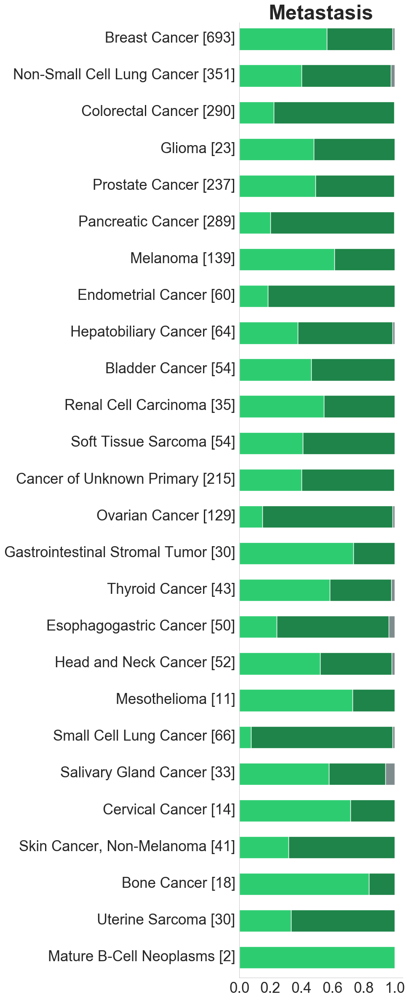

In [5]:
sns.set_style("whitegrid", {'grid.color': '1.'})
prim_met = 'Metastasis'
metrics='tp53_group'
fig, ax = plt.subplots(figsize=(5,30))

def plot_metrics_cancerlist(master: pd.DataFrame, metrics: str, prim_met: str, ax,  legend=True):
    for i, cancer_type in enumerate(cancer_list):
        master_cancer = master[master['Cancer_Type'] == cancer_type][master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()]
        count_prim_met = get_groupby(master_cancer[master_cancer['Sample_Type'] == prim_met], metrics, 'count_prim_met' + metrics)
        freq_prim_met = pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sort_values(by=['count_prim_met' + metrics], ascending=False)/ pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum()
        if legend:
            freq_prim_met.columns=[cancer_type + ' ' + str(pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum().values)]
        else:
            freq_prim_met.columns=[str(pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum().values)]
        if metrics == 'tp53_res_group':
            freq_prim_met = freq_prim_met.reindex(res_group_list)
        elif metrics == 'tp53_group':
            freq_prim_met = freq_prim_met.reindex(group_list)
        if i==0:
            freq_prim_met_final = freq_prim_met.T
        else : freq_prim_met_final = pd.concat([freq_prim_met_final, freq_prim_met.T], axis=0)

    #display(freq_prim_met_final)
    freq_prim_met_final = freq_prim_met_final.fillna(0)
    
    if metrics == 'tp53_res_group':
        h = freq_prim_met_final[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], color=res_palette_list)
    elif metrics == 'tp53_group':
        h = freq_prim_met_final[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], color=palette_list)

    ax.set_title(prim_met, weight = 'bold', fontsize=35)
    ax.legend_.remove()

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    

    for container in ax.containers:
        for i, child in enumerate(container.get_children()):
            child.set_height(0.6)

    ax.set_yticks([k + 0.1 for k in list(range(len(cancer_list)))])
    
    #if legend == False:
    #h.axes.get_yaxis().set_ticks([])
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    
plot_metrics_cancerlist(master=master,
                        metrics='tp53_res_group', 
                        prim_met='Metastasis', 
                        ax=ax,  
                        legend=True)

## TP53 residual groups

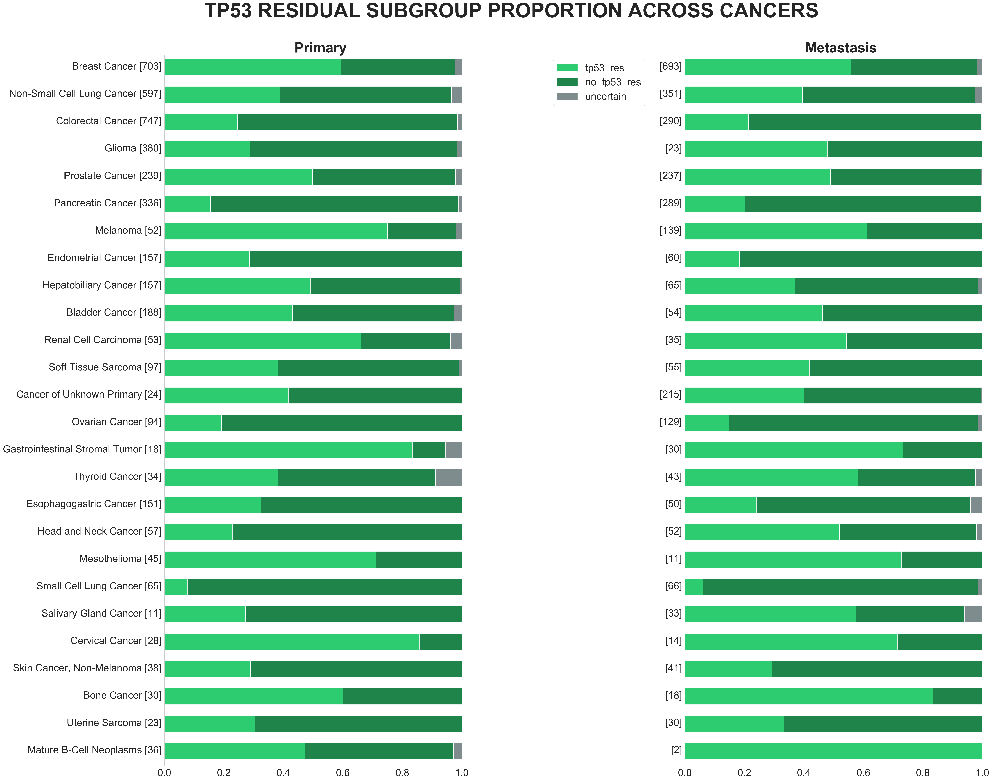

In [55]:
fig = plt.figure(figsize=(40,30))
outer = gridspec.GridSpec(nrows=1, ncols=5)
inner = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=5, subplot_spec=outer[:1, :5],wspace=0.25, hspace=0)

ax_prim = plt.Subplot(fig, inner[0:2])
ax_legend = plt.Subplot(fig, inner[2])
ax_met = plt.Subplot(fig, inner[3:5])

plot_metrics_cancerlist(master=master,
                        metrics='tp53_res_group', 
                        prim_met='Primary', 
                        ax=ax_prim,  
                        legend=True)

res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']
res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']

palette = dict(zip(res_group_list, res_palette_list))
# Create legend handles manually
handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
# Create legend
ax_legend.legend(handles=handles, fontsize=25, loc='left')
# Get current axes object and turn off axis
ax_legend.set_axis_off()

plot_metrics_cancerlist(master=master,
                        metrics='tp53_res_group', 
                        prim_met='Metastasis', 
                        ax=ax_met,  
                        legend=False)

fig.add_subplot(ax_prim)
fig.add_subplot(ax_met)
fig.add_subplot(ax_legend)

fig.subplots_adjust(left=0.2, bottom=0.10, right=0.92, top=0.92, wspace=1, hspace=1)
fig.suptitle('TP53 RESIDUAL SUBGROUP PROPORTION ACROSS CANCERS', fontsize=50,fontweight='bold')
fig.savefig('./metrics_summaries_no_wgd/res_group_proportions.pdf', format='pdf')

## TP53 subgroups

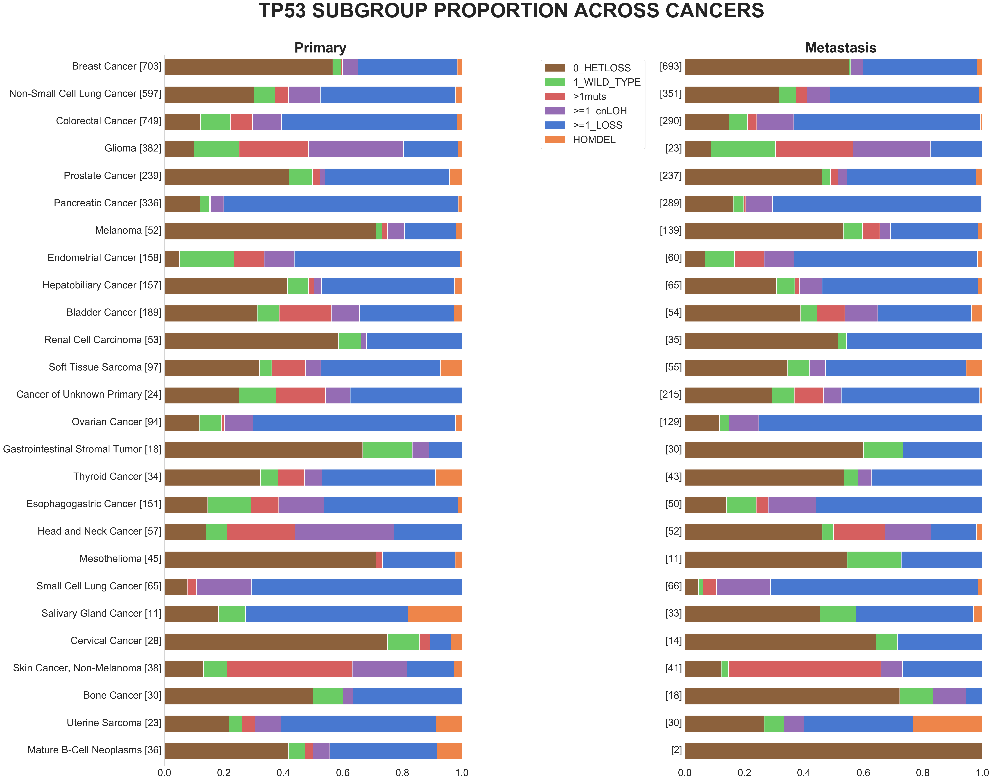

In [56]:
fig = plt.figure(figsize=(40,30))
outer = gridspec.GridSpec(nrows=1, ncols=5)
inner = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=5, subplot_spec=outer[:1, :5],wspace=0.25, hspace=0)
ax_prim = plt.Subplot(fig, inner[0:2])
ax_legend = plt.Subplot(fig, inner[2])
ax_met = plt.Subplot(fig, inner[3:5])

plot_metrics_cancerlist(master=master,
                        metrics='tp53_group', 
                        prim_met='Primary', 
                        ax=ax_prim,  
                        legend=True)


palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
groups = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']

palette = dict(zip(groups, palette_list))
# Create legend handles manually
handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
# Create legend
ax_legend.legend(handles=handles, fontsize=25, loc='left')
# Get current axes object and turn off axis
ax_legend.set_axis_off()


plot_metrics_cancerlist(master=master,
                        metrics='tp53_group', 
                        prim_met='Metastasis', 
                        ax=ax_met,  
                        legend=False)

fig.add_subplot(ax_prim)
fig.add_subplot(ax_legend)
fig.add_subplot(ax_met)

fig.subplots_adjust(left=0.2, bottom=0.10, right=0.92, top=0.92, wspace=1, hspace=1)
fig.suptitle('TP53 SUBGROUP PROPORTION ACROSS CANCERS', fontsize=50,fontweight='bold')
fig.savefig('./metrics_summaries_no_wgd/subgroup_proportions.pdf', format='pdf')

,count_prim_mettp53_res_group
tp53_res_group,
tp53_res,0.394764
no_tp53_res,0.589660
uncertain,0.015576


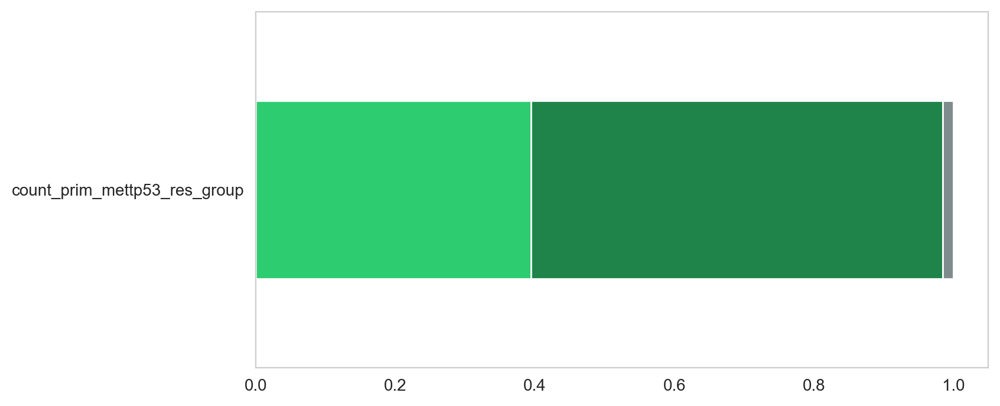

In [57]:
# ZOOM on >=1_cnLOH
metrics = 'tp53_res_group'
master_cancer = master[master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()]
count_prim_met = get_groupby(master_cancer, metrics, 'count_prim_met' + metrics)
freq_prim_met = pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sort_values(by=['count_prim_met' + metrics], ascending=False)/ pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum()
if metrics == 'tp53_res_group':
    freq_prim_met = freq_prim_met.reindex(res_group_list)
display(freq_prim_met)
fig, ax = plt.subplots(figsize=(8,4))
h = freq_prim_met.T[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], color=res_palette_list)
ax.legend_.remove()

---
# WGD Proportion

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
8,P-0036570-T01-IM6_P-0036570-N01-IM6,P-0036570-T01-IM6,P-0036570,Ovarian Cancer,High-Grade Serous Ovarian Cancer,71.0,Primary,0.783647,2.499971,13.611,LIVING,1.05,Stable,1.8,P-0036570-T01-IM617_7578236_A_G,Missense_Mutation,1.000,0.718605,p.Tyr205His,205,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,37750850,HETLOSS,0.783647,False,2,2,0.718605,1.115396,NaN,NaN,NaN,NaN,-0.115396,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,6.0,2.0,3.0,1.0,0.296
9,P-0036570-T02-IM6_P-0036570-N01-IM6,P-0036570-T02-IM6,P-0036570,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,71.0,Primary,0.250258,1.714611,13.611,LIVING,0.00,Stable,3.5,P-0036570-T02-IM617_7577529_A_T,Missense_Mutation,1.000,0.156652,p.Ile251Asn,251,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,14319106,HETLOSS,0.250258,False,4,4,0.161290,1.095276,NaN,NaN,NaN,NaN,-0.095276,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,14.0,8.0,6.0,1.0,0.620
11,P-0007600-T01-IM5_P-0007600-N01-IM5,P-0007600-T01-IM5,P-0007600,Colorectal Cancer,Colon Adenocarcinoma,53.0,Primary,0.300000,1.998037,31.233,DECEASED,0.14,Stable,4.9,P-0007600-T01-IM517_7577121_G_A,Missense_Mutation,0.274,0.048430,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21375631,HETLOSS,0.294082,False,5,5,0.146226,0.274439,NaN,NaN,NaN,NaN,0.725561,NaN,NaN,NaN,NaN,273,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,2.0,1.0,1.0,0.0,0.062
25,P-0000285-T01-IM3_P-0000285-N01-IM3,P-0000285-T01-IM3,P-0000285,Thyroid Cancer,Anaplastic Thyroid Cancer,71.0,Primary,0.745464,1.104588,60.362,LIVING,17.78,Instable,23.4,P-0000285-T01-IM317_7578475_G_-,Frame_Shift_Del,1.000,0.629386,p.Pro152ArgfsTer18,152,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,47585587,HETLOSS,0.745464,False,19,21,0.715757,1.059189,NaN,NaN,NaN,NaN,-0.059189,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,21.0,21.0,0.0,0.0,0.953
37,P-0020739-T01-IM6_P-0020739-N01-IM6,P-0020739-T01-IM6,P-0020739,Colorectal Cancer,Colon Adenocarcinoma,69.0,Primary,0.455517,2.212584,33.008,LIVING,0.69,Stable,6.1,P-0020739-T01-IM617_7577022_G_A,Nonsense_Mutation,1.000,0.308345,p.Arg306Ter,306,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21694810,HETLOSS,0.449452,False,7,7,0.405542,1.045479,NaN,NaN,NaN,NaN,-0.045479,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,10.0,4.0,4.0,3.0,0.359
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

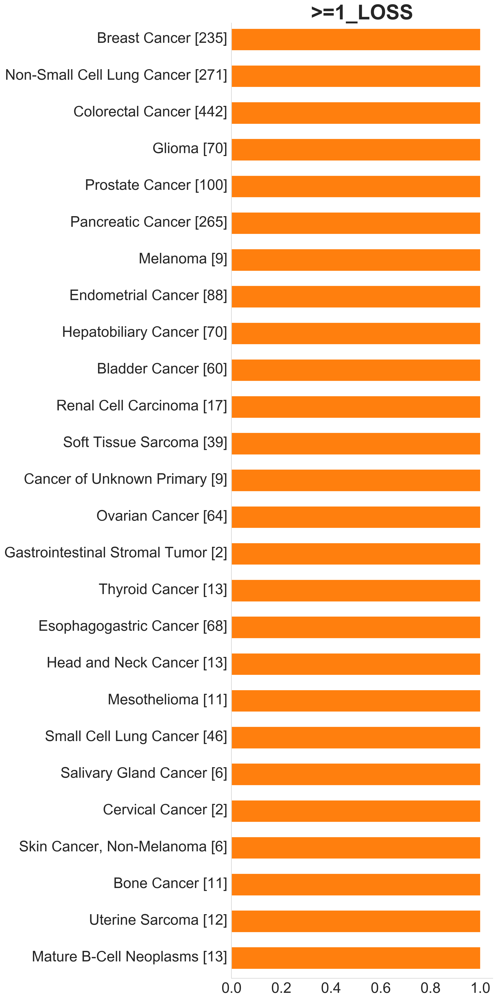

In [58]:
group_choice= 'tp53_res_group'
group = 'tp53_res'
metrics = 'wgd'
title = cancer_type
prim_met='Metastasis'
xlim=1
legend=True

fig = plt.figure(figsize=(8,30))
ax = plt.subplot()

def plot_wgd_cancerlist(master: pd.DataFrame, group_choice:str, group:str, metrics: str, prim_met: str, ax, legend=True, xlim=1):
    sns.set_style("whitegrid", {'axes.grid' : False})
    master_group = master[master[group_choice] == group][master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()][master['Sample_Type'] == prim_met][master['Cancer_Type'].isin(cancer_list)]
    display(master_group)
    count = pd.DataFrame(master_group[['Cancer_Type', 'wgd']].groupby(['Cancer_Type','wgd']).size(), columns=['count_'])
    count = count.unstack()
    count = count.fillna(0)

    
    if len(list(count.columns))==1:
        count['new_column'] = [0]*count.shape[0]
    if len(list(count.columns))==0:
        count['new_column_1'] = [0]*count.shape[0]
        count['new_column_2'] = [0]*count.shape[0]
        count.columns = ['wgd','no_wgd']
    else:
        count.columns = ['no_wgd', 'wgd']
    
    

    if count.shape[0] == 0:
        count['wgd'] = [0]*len(cancer_list)
        count['no_wgd'] = [0]*len(cancer_list)

    count['wgd_r'] = count.apply(lambda x: x.wgd / (x.no_wgd + x.wgd), axis=1)
    count['no_wgd_r'] = count.apply(lambda x: x.no_wgd / (x.no_wgd + x.wgd), axis=1)
    count['sum'] = count[['no_wgd', 'wgd']].sum(axis=1)
    count = count.reindex(cancer_list[::-1])
    count = count.fillna(0)

    df = count[['wgd_r', 'no_wgd_r']]

    new_index = []
    for cancer_type in df.index.tolist():
        if legend:
            new_index.append(cancer_type + ' [' + str(int(count.loc[cancer_type,'sum'])) + ']')
        else:
            new_index.append('[' + str(int(count.loc[cancer_type,'sum'])) + ']')

    df.index = new_index

    h = df.plot(kind = 'barh', stacked=True, ax=ax, yticks=[], color=['#1f77b4','#ff7f0e'])
    ax.legend(fontsize='small', ncol=1)
    ax.set_xlabel('', fontsize=17)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_title(group, weight = 'bold', fontsize=35)
    ax.legend_.remove()

    for container in ax.containers:
        for i, child in enumerate(container.get_children()):
            child.set_height(0.6)

    ax.set_yticks([k + 0.1 for k in list(range(len(cancer_list)))])

    for tick in ax.xaxis.get_major_ticks():
            tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)


plot_wgd_cancerlist(master=master,
                    group_choice='tp53_group',
                    group='>=1_LOSS', 
                    metrics=metrics,
                    prim_met='Primary',
                    ax=ax,
                    legend=True,
                    xlim=1)


In [59]:
def panel_wgd(group_choice, metrics, title, prim_met):
    
    if group_choice == 'tp53_res_group': res='residual'
    else: res=''
    palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
    res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']

    group_list = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']
    res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
    fig = plt.figure(figsize=(50,30))
    if group_choice=='tp53_res_group':
        outer = gridspec.GridSpec(nrows=200, ncols=13)
        inner_1 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, :6],wspace=0.2, hspace=0)
        inner_3 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=1, subplot_spec=outer[90:110, 6],wspace=0.2, hspace=0)
        inner_2 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, 7:13],wspace=0.2, hspace=0)
        
        # Create a color palette
        ax = plt.Subplot(fig, inner_3[0])
        groups = ['no WGD', 'WGD']
        palette_list = ['#ff7f0e','#1f77b4']
        palette = dict(zip(groups, palette_list))
        # Create legend handles manually
        handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
        # Create legend
        ax.legend(handles=handles, fontsize=25, loc='left')
        # Get current axes object and turn off axis
        ax.set_axis_off()
        fig.add_subplot(ax)
        
        for i, group in enumerate(res_group_list):
            ax = plt.Subplot(fig, inner_1[i:i+1])
            if i == 0:
                plot_wgd_cancerlist(master=master,
                    group_choice=group_choice,
                    group=group, 
                    metrics=metrics,
                    prim_met='Primary',
                    ax=ax,
                    legend=True,
                    xlim=1)
        
            else:
                plot_wgd_cancerlist(master=master,
                    group_choice=group_choice,
                    group=group, 
                    metrics=metrics,
                    prim_met='Primary',
                    ax=ax,
                    legend=False,
                    xlim=1)

            fig.add_subplot(ax)
                
        for i, group in enumerate(res_group_list):
            ax = plt.Subplot(fig, inner_2[i:i+1])
            plot_wgd_cancerlist(master=master,
                    group_choice=group_choice,
                    group=group, 
                    metrics=metrics,
                    prim_met='Metastasis',
                    ax=ax,
                    legend=False,
                    xlim=1)
            
            fig.add_subplot(ax)
              
    else: 
        outer = gridspec.GridSpec(nrows=1, ncols=14)
        inner = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=6, subplot_spec=outer[0:1, :12],wspace=0.2, hspace=0)
        inner_bis = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=6, subplot_spec=outer[0:1, 13],wspace=0.2, hspace=0)
        
        # Create a color palette
        ax = plt.Subplot(fig, inner_bis[0])
        groups = ['no WGD', 'WGD']
        palette_list = ['#ff7f0e','#1f77b4']
        palette = dict(zip(groups, palette_list))
        # Create legend handles manually
        handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
        # Create legend
        ax.legend(handles=handles, fontsize=25, loc='left')
        # Get current axes object and turn off axis
        ax.set_axis_off()
        fig.add_subplot(ax)
        
        for i, group in enumerate(group_list):
            ax = plt.Subplot(fig, inner[i:i+1])
            if i == 0:
                plot_wgd_cancerlist(master=master,
                    group_choice=group_choice,
                    group=group, 
                    metrics=metrics,
                    prim_met=prim_met,
                    ax=ax,
                    legend=True,
                    xlim=1)
                
            else:
                plot_wgd_cancerlist(master=master,
                    group_choice=group_choice,
                    group=group, 
                    metrics=metrics,
                    prim_met=prim_met,
                    ax=ax,
                    legend=False,
                    xlim=1)

            fig.add_subplot(ax)

    
    fig.suptitle(title, fontsize=50,fontweight='bold')
    if group_choice == 'tp53_group':
        fig.subplots_adjust(left=0.15, bottom=0.10, right=1, top=0.88, wspace=1, hspace=2)
        fig.savefig('./metrics_summaries_no_wgd/{}_{}.pdf'.format(metrics, prim_met), format='pdf')
    elif group_choice == 'tp53_res_group':
        fig.subplots_adjust(left=0.15, bottom=0.10, right=0.92, top=0.88, wspace=1, hspace=2)
        fig.savefig('./metrics_summaries_no_wgd/{}_residual.pdf'.format(metrics), format='pdf')

## TP53 residual groups

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
13,P-0018520-T01-IM6_P-0018520-N01-IM6,P-0018520-T01-IM6,P-0018520,Breast Cancer,Breast Invasive Ductal Carcinoma,72.0,Primary,0.651383,1.947238,35.079,LIVING,0.15,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21694970,HETLOSS,0.633091,False,3,3,0.498120,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,4.0,3.0,3.0,0.0,0.194
19,P-0001827-T01-IM3_P-0001827-N01-IM3,P-0001827-T01-IM3,P-0001827,Bone Cancer,Chondrosarcoma,60.0,Primary,0.656936,1.525607,20.877,DECEASED,1.31,Stable,1.1,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21694810,HETLOSS,0.566105,False,1,1,0.414035,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,15.0,14.0,1.0,0.0,0.653
47,P-0016335-T01-IM6_P-0016335-N01-IM6,P-0016335-T01-IM6,P-0016335,Breast Cancer,Breast Invasive Lobular Carcinoma,49.0,Primary,0.403738,2.074002,36.230,LIVING,0.08,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,40337800,HETLOSS,0.379546,False,3,3,0.230047,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,6.0,6.0,0.0,0.0,0.223
48,P-0016335-T02-IM6_P-0016335-N01-IM6,P-0016335-T02-IM6,P-0016335,Breast Cancer,Breast Invasive Lobular Carcinoma,49.0,Primary,0.358320,2.137882,36.230,LIVING,0.00,Do not report,1.8,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,33703535,HETLOSS,0.358320,False,2,2,0.167210,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,5.0,5.0,0.0,0.0,0.142
71,P-0020585-T01-IM6_P-0020585-N01-IM6,P-0020585-T01-IM6,P-0020585,Mesothelioma,Pleural Mesothelioma,59.0,Primary,0.536655,2.024693,18.378,LIVING,0.00,Stable,0.9,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,40353981,HETLOSS,0.536655,False,1,1,0.310680,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,5.0,5.0,0.0,0.0,0.184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15982,P-0050567-T01-IM6_P-0050567-N01-IM6,P-0050567-T01-IM6,P-0050567,Colorectal Cancer,Rectal Adenocarcinoma,43.0,Primary,0.511736,2.131833,2.170,LIVING,0.24,Stable,7.0,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,Non

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
8,P-0036570-T01-IM6_P-0036570-N01-IM6,P-0036570-T01-IM6,P-0036570,Ovarian Cancer,High-Grade Serous Ovarian Cancer,71.0,Primary,0.783647,2.499971,13.611,LIVING,1.05,Stable,1.8,P-0036570-T01-IM617_7578236_A_G,Missense_Mutation,1.000,0.718605,p.Tyr205His,205,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,37750850,HETLOSS,0.783647,False,2,2,0.718605,1.115396,NaN,NaN,NaN,NaN,-0.115396,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,6.0,2.0,3.0,1.0,0.296
9,P-0036570-T02-IM6_P-0036570-N01-IM6,P-0036570-T02-IM6,P-0036570,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,71.0,Primary,0.250258,1.714611,13.611,LIVING,0.00,Stable,3.5,P-0036570-T02-IM617_7577529_A_T,Missense_Mutation,1.000,0.156652,p.Ile251Asn,251,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,14319106,HETLOSS,0.250258,False,4,4,0.161290,1.095276,NaN,NaN,NaN,NaN,-0.095276,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,14.0,8.0,6.0,1.0,0.620
25,P-0000285-T01-IM3_P-0000285-N01-IM3,P-0000285-T01-IM3,P-0000285,Thyroid Cancer,Anaplastic Thyroid Cancer,71.0,Primary,0.745464,1.104588,60.362,LIVING,17.78,Instable,23.4,P-0000285-T01-IM317_7578475_G_-,Frame_Shift_Del,1.000,0.629386,p.Pro152ArgfsTer18,152,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,47585587,HETLOSS,0.745464,False,19,21,0.715757,1.059189,NaN,NaN,NaN,NaN,-0.059189,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,21.0,21.0,0.0,0.0,0.953
37,P-0020739-T01-IM6_P-0020739-N01-IM6,P-0020739-T01-IM6,P-0020739,Colorectal Cancer,Colon Adenocarcinoma,69.0,Primary,0.455517,2.212584,33.008,LIVING,0.69,Stable,6.1,P-0020739-T01-IM617_7577022_G_A,Nonsense_Mutation,1.000,0.308345,p.Arg306Ter,306,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21694810,HETLOSS,0.449452,False,7,7,0.405542,1.045479,NaN,NaN,NaN,NaN,-0.045479,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,10.0,4.0,4.0,3.0,0.359
54,P-0037115-T01-IM6_P-0037115-N01-IM6,P-0037115-T01-IM6,P-0037115,Colorectal Cancer,Rectal Adenocarcinoma,78.0,Primary,0.253352,2.367063,4.833,LIVING,0.00,Stable,7.0,P-0037115-T01-IM617_7577538_C_T,Missense_Mutation,0.975,0.141384,p.Arg248Gln,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21421499,HETLOSS,0.253352,False,7,8,0.588235,0.974728,NaN,NaN,NaN,NaN,0.025272,NaN,NaN,NaN,NaN,248,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,7.0,3.0,4.0,1.0,0.265
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
11,P-0007600-T01-IM5_P-0007600-N01-IM5,P-0007600-T01-IM5,P-0007600,Colorectal Cancer,Colon Adenocarcinoma,53.0,Primary,0.300000,1.998037,31.233,DECEASED,0.14,Stable,4.9,P-0007600-T01-IM517_7577121_G_A,Missense_Mutation,0.274,0.048430,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21375631,HETLOSS,0.294082,False,5,5,0.146226,0.274439,NaN,NaN,NaN,NaN,0.725561,NaN,NaN,NaN,NaN,273,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,2.0,1.0,1.0,0.0,0.062
56,P-0002912-T01-IM3_P-0002912-N01-IM3,P-0002912-T01-IM3,P-0002912,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,27.0,Primary,0.318168,2.162368,0.953,LIVING,0.00,Stable,2.2,P-0002912-T01-IM317_7578253_C_T,Missense_Mutation,0.124,0.023529,p.Gly199Glu,199,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21421581,HETLOSS,0.318168,False,2,2,0.104603,0.124376,NaN,NaN,NaN,NaN,0.875624,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,7.0,2.0,4.0,1.0,0.242
432,P-0030233-T01-IM6_P-0030233-N01-IM6,P-0030233-T01-IM6,P-0030233,Thyroid Cancer,Oncocytic Adenoma of the Thyroid,58.0,Primary,0.853464,1.465177,20.811,LIVING,2.07,Stable,NaN,P-0030233-T01-IM617_7578484_-_A,Frame_Shift_Ins,0.541,0.230666,p.Ser149PhefsTer32,149,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,80668369,CNLOH,0.235683,False,1,1,0.230666,0.540540,NaN,NaN,NaN,NaN,1.459460,NaN,NaN,NaN,NaN,truncated,None,None,None,None,cnLOH,>=1_cnLOH,uncertain,True,14.0,14.0,0.0,0.0,0.665
1355,P-0034099-T01-IM6_P-0034099-N01-IM6,P-0034099-T01-IM6,P-0034099,Glioma,Glioblastoma Multiforme,60.0,Primary,0.784406,2.138866,16.997,LIVING,0.34,Stable,3.5,P-0034099-T01-IM617_7577094_G_A,Missense_Mutation,0.403,0.260218,p.Arg282Trp,282,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21430050,HETLOSS,0.418671,False,4,4,0.356061,0.403260,NaN,NaN,NaN,NaN,0.596740,NaN,NaN,NaN,NaN,hotspot,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,8.0,5.0,3.0,0.0,0.310
1491,P-0028793-T01-IM6_P-0028793-N02-IM6,P-0028793-T01-IM6,P-0028793,Colorectal Cancer,Rectal Adenocarcinoma,36.0,Primary,0.516861,2.356320,18.871,LIVING,0.13,Stable,7.0,P-0028793-T01-IM617_7578395_G_A,Missense_Mutation,0.291,0.101538,p.His179Tyr,179,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21430037,HETLOSS,0.323336,False,8,8,0.334144,0.291366,NaN,NaN,NaN,NaN,0.708634,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,6.0,0.0,6.0,0.0,0.250
1699,P-0016262-T01-IM6_P-0016262-N01-IM6,P-0016262-T01-IM6,P-0016262,Breast Cancer,Breast Invasive Ductal Carcinoma,32.0,Primary,0.588439,2.158197,34.652,LIVING,1.28,Do not report,1.8,P-0016262-T01-IM617_7578406_C_T,Missense_Mutation,0.048,0.020000,p.Arg175His,175,None,None,NaN,NaN,Non

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
36,P-0018856-T01-IM6_P-0018856-N01-IM6,P-0018856-T01-IM6,P-0018856,Pancreatic Cancer,Pancreatic Adenocarcinoma,71.0,Metastasis,0.300000,1.778952,17.819,DECEASED,0.22,Do not report,6.1,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21695000,HETLOSS,0.166639,False,6,6,0.139752,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,1.0,1.0,1.0,0.0,0.093
45,P-0017719-T01-IM6_P-0017719-N01-IM6,P-0017719-T01-IM6,P-0017719,Cancer of Unknown Primary,"Neuroendocrine Carcinoma, NOS",78.0,Metastasis,0.622972,2.016771,35.967,LIVING,0.39,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,3705549,HETLOSS,0.619911,False,3,3,0.364407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,10.0,5.0,4.0,1.0,0.450
69,P-0025003-T01-IM6_P-0025003-N01-IM6,P-0025003-T01-IM6,P-0025003,Endometrial Cancer,Uterine Endometrioid Carcinoma,67.0,Metastasis,0.597949,2.552719,27.255,LIVING,19.78,Instable,28.1,P-0025003-T01-IM617_7572991_T_-,Frame_Shift_Del,0.733,0.219207,p.Lys373ArgfsTer49,373,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,80668431,DIPLOID,1.000000,False,29,32,0.584906,0.733196,NaN,NaN,NaN,NaN,1.266804,NaN,NaN,NaN,NaN,truncated,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,3.0,0.0,2.0,0.0,0.189
80,P-0016888-T01-IM6_P-0016888-N01-IM6,P-0016888-T01-IM6,P-0016888,Breast Cancer,Breast Invasive Ductal Carcinoma,55.0,Metastasis,0.540401,1.983831,37.611,LIVING,0.37,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,10437953,HETLOSS,0.540401,False,3,3,0.281362,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,2.0,2.0,0.0,0.0,0.054
88,P-0020167-T01-IM6_P-0020167-N01-IM6,P-0020167-T01-IM6,P-0020167,Bladder Cancer,Bladder Urothelial Carcinoma,70.0,Metastasis,0.599318,1.883526,1.512,DECEASED,0.67,Stable,4.4,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,29307900,HETLOSS,0.579947,False,4,5,0.397638,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,8.0,5.0,2.0,3.0,0.345
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15963,P-0050513-T01-IM6_P-0050513-N01-IM6,P-0050513-T01-IM6,P-0050513,Thyroid Cancer,Medullary Thyroid Cancer,61.0,Metastasis,0.735029,2.109908,N

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
2,P-0027408-T01-IM6_P-0027408-N01-IM6,P-0027408-T01-IM6,P-0027408,Non-Small Cell Lung Cancer,Non-Small Cell Lung Cancer,67.0,Metastasis,0.275073,1.811066,22.586,LIVING,0.27,Stable,17.6,P-0027408-T01-IM617_7578409_CT_TC,Missense_Mutation,1.000,0.168901,p.Arg174Glu,174,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,26256025,HETLOSS,0.275073,False,18,20,0.192475,1.059141,NaN,NaN,NaN,NaN,-0.059141,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,12.0,11.0,3.0,0.0,0.444
7,P-0025997-T01-IM6_P-0025997-N01-IM6,P-0025997-T01-IM6,P-0025997,Cancer of Unknown Primary,Small Cell Carcinoma of Unknown Primary,70.0,Metastasis,0.890374,1.638108,0.000,DECEASED,3.71,Indeterminate,7.9,P-0025997-T01-IM617_7578471_G_-,Frame_Shift_Del,1.000,0.912621,p.Gly154AlafsTer16,154,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,33703681,HETLOSS,0.890374,False,9,9,0.912621,1.137353,NaN,NaN,NaN,NaN,-0.137353,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,9.0,8.0,1.0,1.0,0.478
23,P-0019967-T01-IM6_P-0019967-N01-IM6,P-0019967-T01-IM6,P-0019967,Breast Cancer,Invasive Breast Carcinoma,51.0,Metastasis,0.314864,2.431227,17.129,DECEASED,0.30,Stable,3.5,P-0019967-T01-IM617_7577538_C_T,Missense_Mutation,0.906,0.285298,p.Arg248Gln,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,70004970,CNLOH,0.258662,False,4,4,0.285298,1.812201,NaN,NaN,NaN,NaN,0.187799,NaN,NaN,NaN,NaN,248,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,16.0,10.0,2.0,4.0,0.612
24,P-0019967-T02-IM6_P-0019967-N01-IM6,P-0019967-T02-IM6,P-0019967,Breast Cancer,Breast Invasive Ductal Carcinoma,51.0,Metastasis,0.300000,1.894795,17.129,DECEASED,0.07,Stable,1.8,P-0019967-T02-IM617_7577538_C_T,Missense_Mutation,1.000,0.177570,p.Arg248Gln,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,15821000,HETLOSS,0.284952,False,2,2,0.226158,1.006231,NaN,NaN,NaN,NaN,-0.006231,NaN,NaN,NaN,NaN,248,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,20.0,10.0,3.0,7.0,0.860
33,P-0004517-T01-IM5_P-0004517-N01-IM5,P-0004517-T01-IM5,P-0004517,Non-Small Cell Lung Cancer,Lung Squamous Cell Carcinoma,69.0,Metastasis,0.779950,1.881846,20.975,DECEASED,2.39,Stable,13.8,P-0004517-T01-IM517_7578469_C_A,Missense_Mutation,1.000,0.684783,p.Gly154Val,154,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,24518704,HETLOSS,0.779950,False,14,14,0.757919,1.071183,NaN,NaN,NaN,NaN,-0.071183,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,12.0,11.0,2.0,1.0,0.496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
167,P-0020458-T01-IM6_P-0020458-N01-IM6,P-0020458-T01-IM6,P-0020458,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,67.0,Metastasis,0.688232,2.233681,33.238,LIVING,0.60,Stable,0.9,P-0020458-T01-IM617_7577539_G_A,Missense_Mutation,0.176,0.092417,p.Arg248Trp,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21421694,HETLOSS,0.688232,False,1,1,0.092417,0.176147,NaN,NaN,NaN,NaN,0.823853,NaN,NaN,NaN,NaN,248,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,12.0,2.0,9.0,2.0,0.475
226,P-0013968-T01-IM5_P-0013968-N01-IM5,P-0013968-T01-IM5,P-0013968,Hepatobiliary Cancer,Extrahepatic Cholangiocarcinoma,90.0,Metastasis,NaN,1.831027,NaN,LIVING,25.03,Instable,28.5,P-0013968-T01-IM517_7578413_C_T,Missense_Mutation,NaN,0.337165,p.Val173Met,173,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21694831,HETLOSS,0.481335,False,26,29,0.490196,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,6.0,5.0,0.0,2.0,0.149
391,P-0004647-T01-IM5_P-0004647-N01-IM5,P-0004647-T01-IM5,P-0004647,Esophagogastric Cancer,Stomach Adenocarcinoma,73.0,Metastasis,0.370691,2.229038,0.000,DECEASED,0.00,Stable,9.8,P-0004647-T01-IM517_7577121_G_A,Missense_Mutation,0.478,0.108696,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21430007,HETLOSS,0.233763,False,10,10,0.300175,0.477754,NaN,NaN,NaN,NaN,0.522246,NaN,NaN,NaN,NaN,273,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,10.0,4.0,5.0,0.0,0.378
520,P-0010130-T01-IM5_P-0010130-N01-IM5,P-0010130-T01-IM5,P-0010130,Small Cell Lung Cancer,Combined Small Cell Lung Carcinoma,72.0,Metastasis,0.555785,2.016638,26.499,DECEASED,0.18,Stable,20.7,P-0010130-T01-IM517_7577046_C_A,Nonsense_Mutation,0.297,0.114309,p.Glu298Ter,298,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,17016881,HETLOSS,0.535712,False,21,21,0.340274,0.297034,NaN,NaN,NaN,NaN,0.702966,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,8.0,5.0,1.0,3.0,0.297
1774,P-0014298-T01-IM6_P-0014298-N01-IM6,P-0014298-T01-IM6,P-0014298,Breast Cancer,Breast Invasive Lobular Carcinoma,57.0,Metastasis,0.230683,2.290107,NaN,LIVING,0.00,Do not report,4.4,P-0014298-T01-IM617_7577079_C_A,Nonsense_Mutation,0.157,0.020408,p.Glu287Ter,287,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,80668431,HETLOSS,0.230683,False,5,5,0.135823,0.156529,NaN,NaN,NaN,NaN,0.843471,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,3.0,1.0,2.0,0.0,0.147
2283,P-0001887-T01-IM3_P-0001887-N01-IM3,P-0001887-T01-IM3,P-0001887,Breast Cancer,Breast Invasive Ductal Carcinoma,59.0,Metastasis,NaN,1.821429,15.255,DECEASED,1.22,Stable,1.1,P-0001887-T01-IM317_7578524_G_C,Missense_Mutation,NaN,0.3

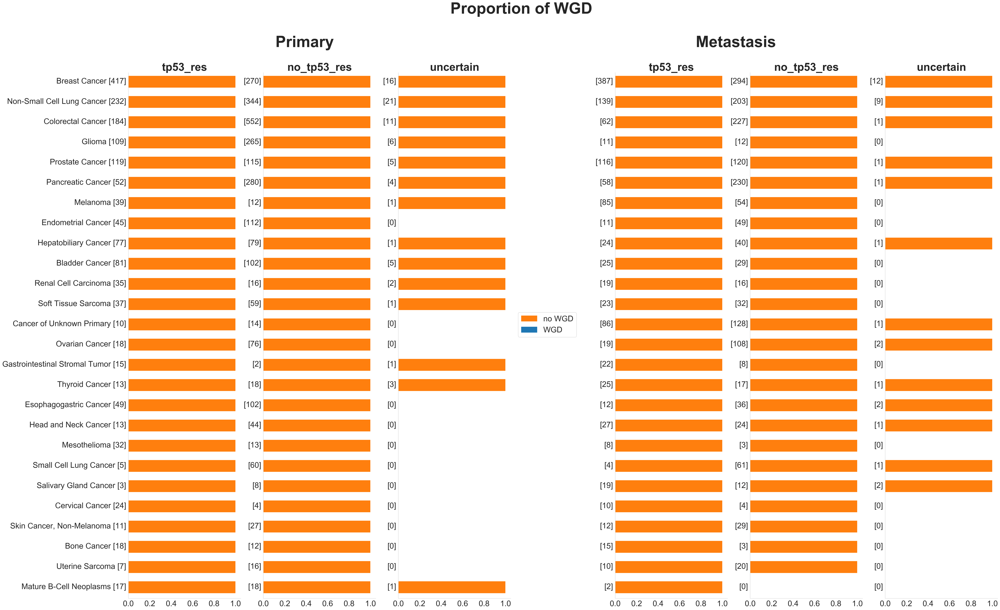

In [60]:
group_choice= 'tp53_res_group'
metrics = 'wgd'
title= ['Proportion of WGD \n\n Primary                                                                                   Metastasis']

panel_wgd(group_choice=group_choice,
          metrics=metrics,
          title=title[0],
          prim_met='Metastasis')


## TP53  subgroups

In [61]:
group_choice= 'tp53_group'
metrics = 'wgd'
titles= ['Proportion of WGD - Primary Samples',
         'Proportion of WGD - Metastatic Samples']

for i,prim_met in enumerate(['Primary', 'Metastasis']):
    panel_wgd(group_choice=group_choice,
                  metrics=metrics,
                  title=titles[i],
                  prim_met=prim_met)

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
13,P-0018520-T01-IM6_P-0018520-N01-IM6,P-0018520-T01-IM6,P-0018520,Breast Cancer,Breast Invasive Ductal Carcinoma,72.0,Primary,0.651383,1.947238,35.079,LIVING,0.15,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21694970,HETLOSS,0.633091,False,3,3,0.498120,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,4.0,3.0,3.0,0.0,0.194
19,P-0001827-T01-IM3_P-0001827-N01-IM3,P-0001827-T01-IM3,P-0001827,Bone Cancer,Chondrosarcoma,60.0,Primary,0.656936,1.525607,20.877,DECEASED,1.31,Stable,1.1,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21694810,HETLOSS,0.566105,False,1,1,0.414035,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,15.0,14.0,1.0,0.0,0.653
47,P-0016335-T01-IM6_P-0016335-N01-IM6,P-0016335-T01-IM6,P-0016335,Breast Cancer,Breast Invasive Lobular Carcinoma,49.0,Primary,0.403738,2.074002,36.230,LIVING,0.08,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,40337800,HETLOSS,0.379546,False,3,3,0.230047,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,6.0,6.0,0.0,0.0,0.223
48,P-0016335-T02-IM6_P-0016335-N01-IM6,P-0016335-T02-IM6,P-0016335,Breast Cancer,Breast Invasive Lobular Carcinoma,49.0,Primary,0.358320,2.137882,36.230,LIVING,0.00,Do not report,1.8,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,33703535,HETLOSS,0.358320,False,2,2,0.167210,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,5.0,5.0,0.0,0.0,0.142
71,P-0020585-T01-IM6_P-0020585-N01-IM6,P-0020585-T01-IM6,P-0020585,Mesothelioma,Pleural Mesothelioma,59.0,Primary,0.536655,2.024693,18.378,LIVING,0.00,Stable,0.9,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,40353981,HETLOSS,0.536655,False,1,1,0.310680,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,5.0,5.0,0.0,0.0,0.184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15964,P-0050494-T01-IM6_P-0050494-N01-IM6,P-0050494-T01-IM6,P-0050494,Breast Cancer,Invasive Breast Carcinoma,77.0,Primary,0.262102,2.255531,2.170,LIVING,0.05,Stable,4.4,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,Non

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
142,P-0002620-T02-IM5_P-0002620-N01-IM5,P-0002620-T02-IM5,P-0002620,Glioma,"High-Grade Glioma, NOS",19.0,Primary,0.916757,1.896856,15.090,DECEASED,1.18,Stable,3.9,P-0002620-T02-IM517_7577509_C_T,Missense_Mutation,0.936,0.428872,p.Glu258Lys,258,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,72140850,DIPLOID,1.0,False,4,4,0.842301,0.935629,NaN,NaN,NaN,NaN,1.064371,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,4.0,3.0,1.0,0.0,0.097
146,P-0035452-T01-IM6_P-0035452-N01-IM6,P-0035452-T01-IM6,P-0035452,Colorectal Cancer,Colon Adenocarcinoma,88.0,Primary,0.392461,3.529132,15.912,LIVING,50.46,Instable,94.8,P-0035452-T01-IM617_7578404_A_G,Missense_Mutation,1.000,0.271758,p.Cys176Arg,176,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,8579004,DIPLOID,1.0,False,91,108,0.645729,1.384893,NaN,NaN,NaN,NaN,0.615107,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,4.0,1.0,3.0,2.0,0.115
222,P-0030222-T01-IM6_P-0030222-N01-IM6,P-0030222-T01-IM6,P-0030222,Glioma,Glioblastoma,69.0,Primary,0.910521,2.243677,9.140,LIVING,0.46,Stable,2.6,P-0030222-T01-IM617_7577118_C_A,Missense_Mutation,0.045,0.020346,p.Val274Phe,274,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,11899032,DIPLOID,1.0,False,3,3,0.844311,0.044691,NaN,NaN,NaN,NaN,1.955309,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,6.0,3.0,4.0,0.0,0.261
224,P-0003274-T02-IM6_P-0003274-N02-IM6,P-0003274-T02-IM6,P-0003274,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,73.0,Primary,0.366811,2.077841,60.427,LIVING,0.06,Stable,4.4,P-0003274-T02-IM617_7577121_G_A,Missense_Mutation,0.145,0.026612,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,21694810,DIPLOID,1.0,False,4,5,0.278679,0.145100,NaN,NaN,NaN,NaN,1.854900,NaN,NaN,NaN,NaN,273,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,2.0,0.0,2.0,0.0,0.068
334,P-0015184-T01-IM6_P-0015184-N01-IM6,P-0015184-T01-IM6,P-0015184,Prostate Cancer,Prostate Adenocarcinoma,78.0,Primary,0.516983,2.355327,37.742,LIVING,0.32,Do not report,1.8,P-0015184-T01-IM617_7578555_C_A,Splice_Site,1.000,0.374200,nan,nan,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,80668481,DIPLOID,1.0,False,2,2,0.374200,1.447631,NaN,NaN,NaN,NaN,0.552369,NaN,NaN,NaN,NaN,truncated,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,6.0,4.0,2.0,2.0,0.179
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
151,P-0028367-T01-IM6_P-0028367-N01-IM6,P-0028367-T01-IM6,P-0028367,Head and Neck Cancer,Oral Cavity Squamous Cell Carcinoma,74.0,Primary,0.468886,1.896462,23.573,LIVING,0.36,Stable,8.8,P-0028367-T01-IM617_7578181_G_A,Missense_Mutation,0.989,0.231844,p.Pro223Leu,223,P-0028367-T01-IM617_7579378_G_C,Nonsense_Mutation,1.000,0.253644,p.Tyr103Ter,103,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668481,DIPLOID,1.000000,False,8,9,0.479381,0.988912,1.081902,NaN,NaN,NaN,1.011088,0.918098,NaN,NaN,NaN,missense,truncated,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,2.0,1.0,1.0,0.0,0.098
192,P-0024668-T01-IM6_P-0024668-N01-IM6,P-0024668-T01-IM6,P-0024668,Glioma,Glioblastoma,65.0,Primary,0.886987,1.970431,9.962,DECEASED,7.47,Indeterminate,204.5,P-0024668-T01-IM617_7577565_T_C,Missense_Mutation,0.871,0.386308,p.Asn239Ser,239,P-0024668-T01-IM617_7578389_G_A,Missense_Mutation,0.919,0.407359,p.Arg181Cys,181,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,30149961,DIPLOID,1.000000,False,151,233,0.924119,0.871057,0.918523,NaN,NaN,NaN,1.128943,1.081477,NaN,NaN,NaN,missense,missense,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,3.0,3.0,0.0,0.0,0.085
373,P-0014303-T01-IM6_P-0014303-N01-IM6,P-0014303-T01-IM6,P-0014303,Soft Tissue Sarcoma,"Sarcoma, NOS",87.0,Primary,0.533217,1.777366,41.030,LIVING,0.62,Do not report,44.8,P-0014303-T01-IM617_7579362_A_T,Missense_Mutation,0.924,0.246452,p.Phe109Ile,109,P-0014303-T01-IM617_7579547_G_-,Frame_Shift_Del,1.000,0.276119,p.Pro47ArgfsTer76,47,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,26255599,DIPLOID,1.000000,False,41,51,0.560694,0.924395,1.035673,NaN,NaN,NaN,1.075605,0.964327,NaN,NaN,NaN,missense,truncated,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,14.0,10.0,1.0,2.0,0.775
414,P-0035850-T01-IM6_P-0035850-N01-IM6,P-0035850-T01-IM6,P-0035850,Glioma,Anaplastic Astrocytoma,41.0,Primary,0.488774,1.980649,9.962,LIVING,0.05,Stable,6.1,P-0035850-T01-IM617_7577121_G_A,Missense_Mutation,1.000,0.245562,p.Arg273Cys,273,P-0035850-T01-IM617_7579373_C_T,Missense_Mutation,0.989,0.241597,p.Gly105Asp,105,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668531,DIPLOID,1.000000,False,6,7,0.519126,1.004808,0.988582,NaN,NaN,NaN,0.995192,1.011418,NaN,NaN,NaN,273,missense,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,4.0,4.0,0.0,0.0,0.147
433,P-0021977-T01-IM6_P-0021977-N01-IM6,P-0021977-T01-IM6,P-0021977,Glioma,Glioblastoma Multiforme,32.0,Primary,0.729734,1.984791,29.786,LIVING,0.13,Stable,5.3,P-0021977-T01-IM617_7577121_G_A,Missense_Mutation,1.000,0.373355,p.Arg273Cys,273,P-0021977-T01-IM617_7578210_TCG_CCA,Missense_Mutation,1.000,0.383193,p.Arg213Trp,213,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668400,DIPLOID,1.000000,False,5,6,0.390558,1.023264,1.050228,NaN,NaN,NaN,0.976736,0.949772,NaN,NaN,NaN,273,hotspot,None,

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
111,P-0032859-T02-IM6_P-0032859-N01-IM6,P-0032859-T02-IM6,P-0032859,Non-Small Cell Lung Cancer,Lung Squamous Cell Carcinoma,73.0,Primary,0.205506,2.023294,18.575,LIVING,0.00,Stable,8.8,P-0032859-T02-IM617_7576857_A_C,Missense_Mutation,1.000,0.145777,p.Leu330Arg,330,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,17016964,CNLOH,0.202527,False,10,10,0.160081,1.418708,NaN,NaN,NaN,NaN,0.581292,NaN,NaN,NaN,NaN,missense,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,11.0,9.0,0.0,2.0,0.501
212,P-0019392-T01-IM6_P-0019392-N01-IM6,P-0019392-T01-IM6,P-0019392,Pancreatic Cancer,Undifferentiated Carcinoma of the Pancreas,75.0,Primary,0.383203,2.044189,34.751,LIVING,0.08,Stable,4.4,P-0019392-T01-IM617_7578504_AGGGCAGGTCTTGGCCAGTTGGCAAAACATCTTGTTG_-,Frame_Shift_Del,0.931,0.178400,p.Asn131CysfsTer27,131,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,80668340,CNLOH,0.290038,False,5,5,0.483810,0.931100,NaN,NaN,NaN,NaN,1.068900,NaN,NaN,NaN,NaN,truncated,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,10.0,5.0,3.0,2.0,0.458
259,P-0009204-T01-IM5_P-0009204-N01-IM5,P-0009204-T01-IM5,P-0009204,Soft Tissue Sarcoma,Pleomorphic Liposarcoma,36.0,Primary,0.783357,1.990458,45.304,LIVING,0.71,Stable,1.0,P-0009204-T01-IM517_7577539_G_A,Missense_Mutation,0.957,0.750000,p.Arg248Trp,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,11930147,CNLOH,0.783357,False,1,1,0.750000,1.914836,NaN,NaN,NaN,NaN,0.085164,NaN,NaN,NaN,NaN,248,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,8.0,7.0,1.0,0.0,0.411
282,P-0013576-T01-IM5_P-0013576-N01-IM5,P-0013576-T01-IM5,P-0013576,Glioma,Glioblastoma Multiforme,54.0,Primary,0.770194,2.237426,5.490,LIVING,1.49,Stable,3.9,P-0013576-T01-IM517_7577121_G_A,Missense_Mutation,1.000,0.786260,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,38398000,CNLOH,0.770194,False,4,4,0.786260,2.041717,NaN,NaN,NaN,NaN,-0.041717,NaN,NaN,NaN,NaN,273,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,11.0,1.0,8.0,2.0,0.476
318,P-0006626-T01-IM5_P-0006626-N01-IM5,P-0006626-T01-IM5,P-0006626,Pancreatic Cancer,Pancreatic Adenocarcinoma,81.0,Primary,0.352645,2.017653,0.493,DECEASED,0.36,Stable,3.0,P-0006626-T01-IM517_7578271_T_A,Missense_Mutation,1.000,0.366428,p.His193Leu,193,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,80668340,CNLOH,0.348214,False,3,3,0.366428,2.078171,NaN,NaN,NaN,NaN,-0.078171,NaN,NaN,NaN,NaN,missense,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,12.0,3.0,9.0,1.0,0.449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
8,P-0036570-T01-IM6_P-0036570-N01-IM6,P-0036570-T01-IM6,P-0036570,Ovarian Cancer,High-Grade Serous Ovarian Cancer,71.0,Primary,0.783647,2.499971,13.611,LIVING,1.05,Stable,1.8,P-0036570-T01-IM617_7578236_A_G,Missense_Mutation,1.000,0.718605,p.Tyr205His,205,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,37750850,HETLOSS,0.783647,False,2,2,0.718605,1.115396,NaN,NaN,NaN,NaN,-0.115396,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,6.0,2.0,3.0,1.0,0.296
9,P-0036570-T02-IM6_P-0036570-N01-IM6,P-0036570-T02-IM6,P-0036570,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,71.0,Primary,0.250258,1.714611,13.611,LIVING,0.00,Stable,3.5,P-0036570-T02-IM617_7577529_A_T,Missense_Mutation,1.000,0.156652,p.Ile251Asn,251,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,14319106,HETLOSS,0.250258,False,4,4,0.161290,1.095276,NaN,NaN,NaN,NaN,-0.095276,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,14.0,8.0,6.0,1.0,0.620
11,P-0007600-T01-IM5_P-0007600-N01-IM5,P-0007600-T01-IM5,P-0007600,Colorectal Cancer,Colon Adenocarcinoma,53.0,Primary,0.300000,1.998037,31.233,DECEASED,0.14,Stable,4.9,P-0007600-T01-IM517_7577121_G_A,Missense_Mutation,0.274,0.048430,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21375631,HETLOSS,0.294082,False,5,5,0.146226,0.274439,NaN,NaN,NaN,NaN,0.725561,NaN,NaN,NaN,NaN,273,None,None,None,None,LOSS,>=1_LOSS,uncertain,True,2.0,1.0,1.0,0.0,0.062
25,P-0000285-T01-IM3_P-0000285-N01-IM3,P-0000285-T01-IM3,P-0000285,Thyroid Cancer,Anaplastic Thyroid Cancer,71.0,Primary,0.745464,1.104588,60.362,LIVING,17.78,Instable,23.4,P-0000285-T01-IM317_7578475_G_-,Frame_Shift_Del,1.000,0.629386,p.Pro152ArgfsTer18,152,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,47585587,HETLOSS,0.745464,False,19,21,0.715757,1.059189,NaN,NaN,NaN,NaN,-0.059189,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,21.0,21.0,0.0,0.0,0.953
37,P-0020739-T01-IM6_P-0020739-N01-IM6,P-0020739-T01-IM6,P-0020739,Colorectal Cancer,Colon Adenocarcinoma,69.0,Primary,0.455517,2.212584,33.008,LIVING,0.69,Stable,6.1,P-0020739-T01-IM617_7577022_G_A,Nonsense_Mutation,1.000,0.308345,p.Arg306Ter,306,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21694810,HETLOSS,0.449452,False,7,7,0.405542,1.045479,NaN,NaN,NaN,NaN,-0.045479,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,10.0,4.0,4.0,3.0,0.359
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
138,P-0002544-T01-IM3_P-0002544-N01-IM3,P-0002544-T01-IM3,P-0002544,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,62.0,Primary,0.407165,1.963446,61.644,LIVING,0.00,Stable,4.5,P-0002544-T01-IM317_7577121_G_A,Missense_Mutation,0.097,0.033333,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,0,0.0,0.0,9561900,HOMDEL,0.126472,False,4,4,0.242857,0.097067,NaN,NaN,NaN,NaN,-0.097067,NaN,NaN,NaN,NaN,273,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,5.0,1.0,4.0,0.0,0.170
178,P-0004454-T01-IM5_P-0004454-N01-IM5,P-0004454-T01-IM5,P-0004454,Colorectal Cancer,Colon Adenocarcinoma,82.0,Primary,0.211260,1.802340,34.619,LIVING,0.15,Stable,5.9,P-0004454-T01-IM517_7577022_G_A,Nonsense_Mutation,0.854,0.343210,p.Arg306Ter,306,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,0,0.0,0.0,38452131,HOMDEL,0.188100,False,6,6,0.343210,2.562753,NaN,NaN,NaN,NaN,-2.562753,NaN,NaN,NaN,NaN,truncated,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,6.0,6.0,1.0,0.0,0.215
187,P-0011128-T01-IM5_P-0011128-N01-IM5,P-0011128-T01-IM5,P-0011128,Hepatobiliary Cancer,Hepatocellular Carcinoma,75.0,Primary,0.282318,1.963957,1.545,DECEASED,0.07,Stable,8.9,P-0011128-T01-IM517_7577548_C_G,Missense_Mutation,0.960,0.566568,p.Gly245Arg,245,P-0011128-T01-IM517_7578542_G_A,Missense_Mutation,0.398,0.078333,p.Leu130Phe,130,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,0,0.0,0.0,21375421,HOMDEL,0.282318,False,8,9,0.566568,2.880544,0.398262,NaN,NaN,NaN,-2.880544,-0.398262,NaN,NaN,NaN,hotspot,missense,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,10.0,6.0,1.0,1.0,0.375
189,P-0017446-T01-IM6_P-0017446-N01-IM6,P-0017446-T01-IM6,P-0017446,Pancreatic Cancer,Pancreatic Adenocarcinoma,69.0,Primary,0.352767,1.910534,11.868,DECEASED,0.00,Do not report,3.5,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,0,0.0,0.0,21375421,HOMDEL,0.269649,False,4,4,0.364706,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,3.0,3.0,0.0,0.0,0.057
273,P-0036328-T01-IM6_P-0036328-N01-IM6,P-0036328-T01-IM6,P-0036328,Mesothelioma,"Pleural Mesothelioma, Epithelioid Type",76.0,Primary,0.458388,2.099374,1.973,DECEASED,0.00,Stable,0.9,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,0,0.0,0.0,88175,HOMDEL,0.458388,False,1,1,0.201469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,10.0,4.0,3.0,3.0,0.296
353,P-0032646-T01-IM6_P-0032646-N01-IM6,P-0032646-T01-IM6,P-0032646,Prostate Cancer,Prostate Adenocarcinoma,74.0,Primary,0.375786,1.933653,16.438,LIVING,0.00,Stable,1.8,P-0032646-T01-IM617_7576888_T_A,Nonsense_Mutation,0.791,0.475983,p.Lys320Ter,320,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,Na

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
36,P-0018856-T01-IM6_P-0018856-N01-IM6,P-0018856-T01-IM6,P-0018856,Pancreatic Cancer,Pancreatic Adenocarcinoma,71.0,Metastasis,0.300000,1.778952,17.819,DECEASED,0.22,Do not report,6.1,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,21695000,HETLOSS,0.166639,False,6,6,0.139752,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,1.0,1.0,1.0,0.0,0.093
45,P-0017719-T01-IM6_P-0017719-N01-IM6,P-0017719-T01-IM6,P-0017719,Cancer of Unknown Primary,"Neuroendocrine Carcinoma, NOS",78.0,Metastasis,0.622972,2.016771,35.967,LIVING,0.39,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,3705549,HETLOSS,0.619911,False,3,3,0.364407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,10.0,5.0,4.0,1.0,0.450
80,P-0016888-T01-IM6_P-0016888-N01-IM6,P-0016888-T01-IM6,P-0016888,Breast Cancer,Breast Invasive Ductal Carcinoma,55.0,Metastasis,0.540401,1.983831,37.611,LIVING,0.37,Do not report,2.6,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,10437953,HETLOSS,0.540401,False,3,3,0.281362,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,2.0,2.0,0.0,0.0,0.054
88,P-0020167-T01-IM6_P-0020167-N01-IM6,P-0020167-T01-IM6,P-0020167,Bladder Cancer,Bladder Urothelial Carcinoma,70.0,Metastasis,0.599318,1.883526,1.512,DECEASED,0.67,Stable,4.4,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,29307900,HETLOSS,0.579947,False,4,5,0.397638,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,8.0,5.0,2.0,3.0,0.345
94,P-0004265-T01-IM5_P-0004265-N01-IM5,P-0004265-T01-IM5,P-0004265,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,56.0,Metastasis,0.762345,1.555961,12.953,DECEASED,0.37,Stable,3.0,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,1,1.0,0.0,17016681,HETLOSS,0.746902,False,3,3,0.646907,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,LOSS,0_HETLOSS,tp53_res,True,19.0,16.0,4.0,0.0,0.796
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15949,P-0050426-T01-IM6_P-0050426-N01-IM6,P-0050426-T01-IM6,P-0050426,Prostate Cancer,Prostate Adenocarcinoma,60.0,Metastasis,0.570498,1.920466,NaN,LIVING,0.22,Stable,4.4,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
69,P-0025003-T01-IM6_P-0025003-N01-IM6,P-0025003-T01-IM6,P-0025003,Endometrial Cancer,Uterine Endometrioid Carcinoma,67.0,Metastasis,0.597949,2.552719,27.255,LIVING,19.78,Instable,28.1,P-0025003-T01-IM617_7572991_T_-,Frame_Shift_Del,0.733,0.219207,p.Lys373ArgfsTer49,373,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,80668431,DIPLOID,1.0,False,29,32,0.584906,0.733196,NaN,NaN,NaN,NaN,1.266804,NaN,NaN,NaN,NaN,truncated,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,3.0,0.0,2.0,0.0,0.189
202,P-0034396-T01-IM6_P-0034396-N01-IM6,P-0034396-T01-IM6,P-0034396,Colorectal Cancer,Colorectal Adenocarcinoma,42.0,Metastasis,0.379360,3.060224,0.592,LIVING,0.00,Stable,2.6,P-0034396-T01-IM617_7578547_G_-,Frame_Shift_Del,0.467,0.088529,p.Pro128LeufsTer42,128,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,80668582,DIPLOID,1.0,False,2,3,0.088529,0.466726,NaN,NaN,NaN,NaN,1.533274,NaN,NaN,NaN,NaN,truncated,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,5.0,1.0,4.0,1.0,0.160
366,P-0010689-T01-IM5_P-0010689-N01-IM5,P-0010689-T01-IM5,P-0010689,Pancreatic Cancer,Pancreatic Adenocarcinoma,60.0,Metastasis,0.347572,1.873735,4.866,DECEASED,0.15,Stable,3.0,P-0010689-T01-IM517_7578286_A_T,Missense_Mutation,1.000,0.192347,p.Leu188Gln,188,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,17016881,DIPLOID,1.0,False,3,3,0.192347,1.106808,NaN,NaN,NaN,NaN,0.893192,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,10.0,7.0,3.0,2.0,0.506
430,P-0011081-T01-IM5_P-0011081-N01-IM5,P-0011081-T01-IM5,P-0011081,Melanoma,Cutaneous Melanoma,74.0,Metastasis,0.838103,2.019135,0.953,DECEASED,0.80,Stable,8.9,P-0011081-T01-IM517_7579473_GG_AA,Missense_Mutation,0.822,0.344340,p.Pro72Ser,72,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,38397881,DIPLOID,1.0,False,9,9,0.584746,0.821712,NaN,NaN,NaN,NaN,1.178288,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,7.0,3.0,4.0,0.0,0.241
434,P-0035375-T01-IM6_P-0035375-N01-IM6,P-0035375-T01-IM6,P-0035375,Colorectal Cancer,Colorectal Adenocarcinoma,38.0,Metastasis,0.678868,2.326918,15.879,LIVING,0.44,Stable,9.7,P-0035375-T01-IM617_7578526_C_A,Missense_Mutation,0.993,0.336889,p.Cys135Phe,135,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,1.0,1.0,80668574,DIPLOID,1.0,False,10,11,0.526124,0.992502,NaN,NaN,NaN,NaN,1.007498,NaN,NaN,NaN,NaN,missense,None,None,None,None,WILD_TYPE,1_WILD_TYPE,tp53_res,False,7.0,1.0,6.0,0.0,0.343
595,P-0031688-T01-IM6_P-0031688-N01-IM6,P-0031688-T01-IM6,P-0031688,Non-Small Cell Lung Cancer,Lung Squamous Cell Carcinoma,67.0,Metastasis,0.621848,2.233315,18.510,DECEASED,0.00,Stable,3.5,P-0031688-T01-IM617_7577547_C_T,Missense_Mu

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
63,P-0022536-T01-IM6_P-0022536-N01-IM6,P-0022536-T01-IM6,P-0022536,Glioma,Glioblastoma Multiforme,65.0,Metastasis,0.621794,1.964867,3.255,DECEASED,0.14,Stable,4.4,P-0022536-T01-IM617_7577094_G_A,Missense_Mutation,0.961,0.298893,p.Arg282Trp,282,P-0022536-T01-IM617_7577120_C_T,Missense_Mutation,1.000,0.314172,p.Arg273His,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668511,DIPLOID,1.000000,False,5,6,0.524109,0.961389,1.010535,NaN,NaN,NaN,1.038611,0.989465,NaN,NaN,NaN,hotspot,273,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,5.0,4.0,1.0,0.0,0.176
129,P-0006754-T01-IM5_P-0006754-N01-IM5,P-0006754-T01-IM5,P-0006754,"Skin Cancer, Non-Melanoma",Cutaneous Squamous Cell Carcinoma,83.0,Metastasis,0.207614,1.894433,18.016,DECEASED,0.15,Stable,64.9,P-0006754-T01-IM517_7577539_G_A,Missense_Mutation,0.567,0.058875,p.Arg248Trp,248,P-0006754-T01-IM517_7579414_CC_TT,Nonsense_Mutation,1.000,0.104612,p.Trp91Ter,91,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668479,DIPLOID,1.000000,False,55,66,0.189802,0.567161,1.007756,NaN,NaN,NaN,1.432839,0.992244,NaN,NaN,NaN,248,truncated,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,5.0,5.0,0.0,1.0,0.216
194,P-0026297-T01-IM6_P-0026297-N01-IM6,P-0026297-T01-IM6,P-0026297,Endometrial Cancer,Uterine Endometrioid Carcinoma,80.0,Metastasis,0.733823,2.034498,25.479,LIVING,5.04,Indeterminate,395.0,P-0026297-T01-IM617_7574017_C_T,Missense_Mutation,1.000,0.371869,p.Arg337His,337,P-0026297-T01-IM617_7577079_C_A,Nonsense_Mutation,0.895,0.328358,p.Glu287Ter,287,P-0026297-T01-IM617_7578277_G_T,Missense_Mutation,1.000,0.423002,p.Pro191His,191,P-0026297-T01-IM617_7578421_G_A,Missense_Mutation,0.969,0.355372,p.Thr170Met,170,None,None,NaN,NaN,None,None,4,2,1.0,1.0,80668414,DIPLOID,1.000000,False,234,450,0.492683,1.013512,0.894925,1.152873,0.968550,NaN,0.986488,1.105075,0.847127,1.031450,NaN,missense,truncated,missense,missense,None,WILD_TYPE,>1muts,no_tp53_res,False,1.0,0.0,0.0,1.0,0.029
386,P-0013749-T02-IM6_P-0013749-N01-IM6,P-0013749-T02-IM6,P-0013749,Pancreatic Cancer,Pancreatic Neuroendocrine Tumor,50.0,Metastasis,0.279047,1.521436,4.964,LIVING,0.06,Stable,105.3,P-0013749-T02-IM617_7577538_C_T,Missense_Mutation,0.575,0.080184,p.Arg248Gln,248,P-0013749-T02-IM617_7578406_C_T,Missense_Mutation,1.000,0.144000,p.Arg175His,175,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,2,2,1.0,1.0,80668481,DIPLOID,1.000000,False,94,120,0.149466,0.574700,1.032083,NaN,NaN,NaN,1.425300,0.967917,NaN,NaN,NaN,248,175,None,None,None,WILD_TYPE,>1muts,no_tp53_res,False,12.0,12.0,0.0,0.0,0.604
555,P-0004228-T01-IM5_P-0004228-N01-IM5,P-0004228-T01-IM5,P-0004228,Esophagogastric Cancer,Esophagogastric Adenocarcinoma,71.0,Metastasis,0.547164,2.126121,5.227,DECEASED,0.43,Stable,23.6,P-0004228-T01-IM517_7577058_C_A,Nonsense_Mutation,0.814,0.222689,p.Glu294Ter,294,P-0004228-T01-IM517_7579311_C_T,Splice_Site,1.000,0.365517,nan,nan,None,None,NaN,NaN,None,None,Non

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
23,P-0019967-T01-IM6_P-0019967-N01-IM6,P-0019967-T01-IM6,P-0019967,Breast Cancer,Invasive Breast Carcinoma,51.0,Metastasis,0.314864,2.431227,17.129,DECEASED,0.30,Stable,3.5,P-0019967-T01-IM617_7577538_C_T,Missense_Mutation,0.906,0.285298,p.Arg248Gln,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,70004970,CNLOH,0.258662,False,4,4,0.285298,1.812201,NaN,NaN,NaN,NaN,0.187799,NaN,NaN,NaN,NaN,248,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,16.0,10.0,2.0,4.0,0.612
57,P-0005091-T01-IM5_P-0005091-N01-IM5,P-0005091-T01-IM5,P-0005091,Colorectal Cancer,Rectal Adenocarcinoma,74.0,Metastasis,0.688944,2.345533,32.614,DECEASED,1.47,Stable,4.9,P-0005091-T01-IM517_7578467_-_GCCGGGC,Frame_Shift_Ins,0.841,0.579448,p.Thr155AlafsTer28,155,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,28947303,CNLOH,0.688944,False,5,5,0.579448,1.682135,NaN,NaN,NaN,NaN,0.317865,NaN,NaN,NaN,NaN,truncated,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,9.0,3.0,5.0,2.0,0.317
580,P-0007006-T01-IM5_P-0007006-N01-IM5,P-0007006-T01-IM5,P-0007006,Prostate Cancer,Prostate Adenocarcinoma,86.0,Metastasis,0.412499,1.570094,3.353,DECEASED,0.07,Stable,3.9,P-0007006-T01-IM517_7577120_C_T,Missense_Mutation,0.956,0.394541,p.Arg273His,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,29548681,CNLOH,0.338692,False,4,4,0.394541,1.912931,NaN,NaN,NaN,NaN,0.087069,NaN,NaN,NaN,NaN,273,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,14.0,14.0,0.0,0.0,0.728
599,P-0030003-T01-IM6_P-0030003-N01-IM6,P-0030003-T01-IM6,P-0030003,Breast Cancer,Breast Invasive Ductal Carcinoma,84.0,Metastasis,0.223772,2.377308,12.000,DECEASED,0.10,Stable,3.5,P-0030003-T01-IM617_7578265_A_G,Missense_Mutation,1.000,0.226164,p.Ile195Thr,195,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,80668531,CNLOH,0.216764,False,4,4,0.226164,2.021380,NaN,NaN,NaN,NaN,-0.021380,NaN,NaN,NaN,NaN,missense,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,13.0,6.0,7.0,2.0,0.525
685,P-0012900-T01-IM5_P-0012900-N01-IM5,P-0012900-T01-IM5,P-0012900,Colorectal Cancer,Colon Adenocarcinoma,72.0,Metastasis,0.375519,2.265279,44.055,LIVING,0.89,Stable,3.0,P-0012900-T01-IM517_7572929_A_T,Nonstop_Mutation,0.920,0.690952,p.Ter394ArgextTer9,394,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2,2.0,0.0,7998848,CNLOH,0.375519,False,3,3,0.690952,3.679981,NaN,NaN,NaN,NaN,-1.679981,NaN,NaN,NaN,NaN,None,None,None,None,None,cnLOH,>=1_cnLOH,no_tp53_res,True,17.0,11.0,4.0,1.0,0.720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
2,P-0027408-T01-IM6_P-0027408-N01-IM6,P-0027408-T01-IM6,P-0027408,Non-Small Cell Lung Cancer,Non-Small Cell Lung Cancer,67.0,Metastasis,0.275073,1.811066,22.586,LIVING,0.27,Stable,17.6,P-0027408-T01-IM617_7578409_CT_TC,Missense_Mutation,1.000,0.168901,p.Arg174Glu,174,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,26256025,HETLOSS,0.275073,False,18,20,0.192475,1.059141,NaN,NaN,NaN,NaN,-0.059141,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,12.0,11.0,3.0,0.0,0.444
7,P-0025997-T01-IM6_P-0025997-N01-IM6,P-0025997-T01-IM6,P-0025997,Cancer of Unknown Primary,Small Cell Carcinoma of Unknown Primary,70.0,Metastasis,0.890374,1.638108,0.000,DECEASED,3.71,Indeterminate,7.9,P-0025997-T01-IM617_7578471_G_-,Frame_Shift_Del,1.000,0.912621,p.Gly154AlafsTer16,154,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,33703681,HETLOSS,0.890374,False,9,9,0.912621,1.137353,NaN,NaN,NaN,NaN,-0.137353,NaN,NaN,NaN,NaN,truncated,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,9.0,8.0,1.0,1.0,0.478
24,P-0019967-T02-IM6_P-0019967-N01-IM6,P-0019967-T02-IM6,P-0019967,Breast Cancer,Breast Invasive Ductal Carcinoma,51.0,Metastasis,0.300000,1.894795,17.129,DECEASED,0.07,Stable,1.8,P-0019967-T02-IM617_7577538_C_T,Missense_Mutation,1.000,0.177570,p.Arg248Gln,248,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,15821000,HETLOSS,0.284952,False,2,2,0.226158,1.006231,NaN,NaN,NaN,NaN,-0.006231,NaN,NaN,NaN,NaN,248,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,20.0,10.0,3.0,7.0,0.860
33,P-0004517-T01-IM5_P-0004517-N01-IM5,P-0004517-T01-IM5,P-0004517,Non-Small Cell Lung Cancer,Lung Squamous Cell Carcinoma,69.0,Metastasis,0.779950,1.881846,20.975,DECEASED,2.39,Stable,13.8,P-0004517-T01-IM517_7578469_C_A,Missense_Mutation,1.000,0.684783,p.Gly154Val,154,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,24518704,HETLOSS,0.779950,False,14,14,0.757919,1.071183,NaN,NaN,NaN,NaN,-0.071183,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,12.0,11.0,2.0,1.0,0.496
64,P-0018242-T01-IM6_P-0018242-N01-IM6,P-0018242-T01-IM6,P-0018242,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,63.0,Metastasis,0.480612,1.873009,19.331,DECEASED,0.12,Do not report,3.5,P-0018242-T01-IM617_7577153_C_A,Missense_Mutation,1.000,0.331476,p.Gly262Val,262,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1,1.0,0.0,21430005,HETLOSS,0.480612,False,4,4,0.331476,1.047915,NaN,NaN,NaN,NaN,-0.047915,NaN,NaN,NaN,NaN,missense,None,None,None,None,LOSS,>=1_LOSS,no_tp53_res,True,11.0,9.0,3.0,0.0,0.478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Patient_Current_Age,Sample_Type,purity,ploidy,Overall_Survival_Months,Overall_Survival_Status,MSI_Score,MSI_Type,TMB_Score,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,gene_count,mutation_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_res_1,tp53_res_2,tp53_res_3,tp53_res_4,tp53_res_5,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_first_group,tp53_group,tp53_res_group,loh_status,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered
168,P-0030780-T01-IM6_P-0030780-N01-IM6,P-0030780-T01-IM6,P-0030780,Uterine Sarcoma,Uterine Leiomyosarcoma,42.0,Metastasis,0.219345,2.438651,NaN,LIVING,0.00,Stable,1.8,P-0030780-T01-IM617_7577534_C_G,Missense_Mutation,1.000,0.150838,p.Arg249Ser,249,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,0,0.0,0.0,7993646,HOMDEL,0.162658,False,2,2,0.150838,1.073674,NaN,NaN,NaN,NaN,-1.073674,NaN,NaN,NaN,NaN,missense,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,5.0,3.0,2.0,0.0,0.203
257,P-0015337-T01-IM6_P-0015337-N01-IM6,P-0015337-T01-IM6,P-0015337,Soft Tissue Sarcoma,Leiomyosarcoma,61.0,Metastasis,0.950547,1.829655,10.652,DECEASED,1.67,Do not report,5.3,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,0,0.0,0.0,362700,HOMDEL,0.945052,False,3,6,0.861582,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,4.0,4.0,0.0,0.0,0.143
300,P-0002978-T06-IM6_P-0002978-N01-IM6,P-0002978-T06-IM6,P-0002978,Salivary Gland Cancer,Mammary Analogue Secretory Carcinoma of Salivary Gland Origin,44.0,Metastasis,0.513616,2.018861,21.304,DECEASED,0.47,Do not report,1.8,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,0,0.0,0.0,88040,HOMDEL,0.399847,False,2,2,0.381188,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,12.0,7.0,4.0,1.0,0.366
611,P-0015660-T01-IM6_P-0015660-N01-IM6,P-0015660-T01-IM6,P-0015660,Bladder Cancer,Bladder Urothelial Carcinoma,71.0,Metastasis,0.334595,1.865205,14.795,DECEASED,0.20,Do not report,9.7,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,0,0.0,0.0,27253647,HOMDEL,0.193873,False,10,11,0.251333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,10.0,3.0,2.0,6.0,0.487
870,P-0022584-T02-IM6_P-0022584-N01-IM6,P-0022584-T02-IM6,P-0022584,Prostate Cancer,Prostate Adenocarcinoma,59.0,Metastasis,0.342082,1.746070,30.444,LIVING,0.15,Stable,0.9,P-0022584-T02-IM617_7576852_C_A,Splice_Site,0.668,0.520761,nan,nan,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,0,0.0,0.0,7996303,HOMDEL,0.327745,False,1,1,0.520761,2.003134,NaN,NaN,NaN,NaN,-2.003134,NaN,NaN,NaN,NaN,truncated,None,None,None,None,HOMDEL,HOMDEL,no_tp53_res,True,6.0,6.0,0.0,0.0,0.239
1624,P-0036276-T01-IM6_P-0036276-N01-IM6,P-0036276-T01-IM6,P-0036276,Breast Cancer,"Breast Invasive Carcinoma, NOS",56.0,Metastasis,0.235406,1.893981,13.381,DECEASED,0.00,Stable,15.8,P-0036276-T01-IM617_7577099_C_G,Missense_Mutation,0.949,0.146104,p.Arg280Thr,280,P-0036276-T01-IM617_7579558_C_G,Missense_Mutation,0.883,0.136,p.Leu43Phe,43,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None

In [62]:
get_groupby(master[master['tp53_group'] == '>=1_cnLOH'][master['Sample_Type'] == 'Metastasis'][master['Cancer_Type'] == 'Peripheral Nervous System'],'wgd', 'count')

,count
wgd,


---
# Genome Instability Metrics

In [63]:
def style(ax1):
    for i, artist in enumerate(ax1.artists):
        # Set the linecolor on the artist to the facecolor, and set the facecolor to None
        artist.set_edgecolor('black')

        # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
        # Loop over them here, and use the same colour as above
        for j in range(i * 6, i * 6 + 6):
            line = ax1.lines[j]
            line.set_color('black')
            line.set_mfc('None')
            line.set_mec('None')

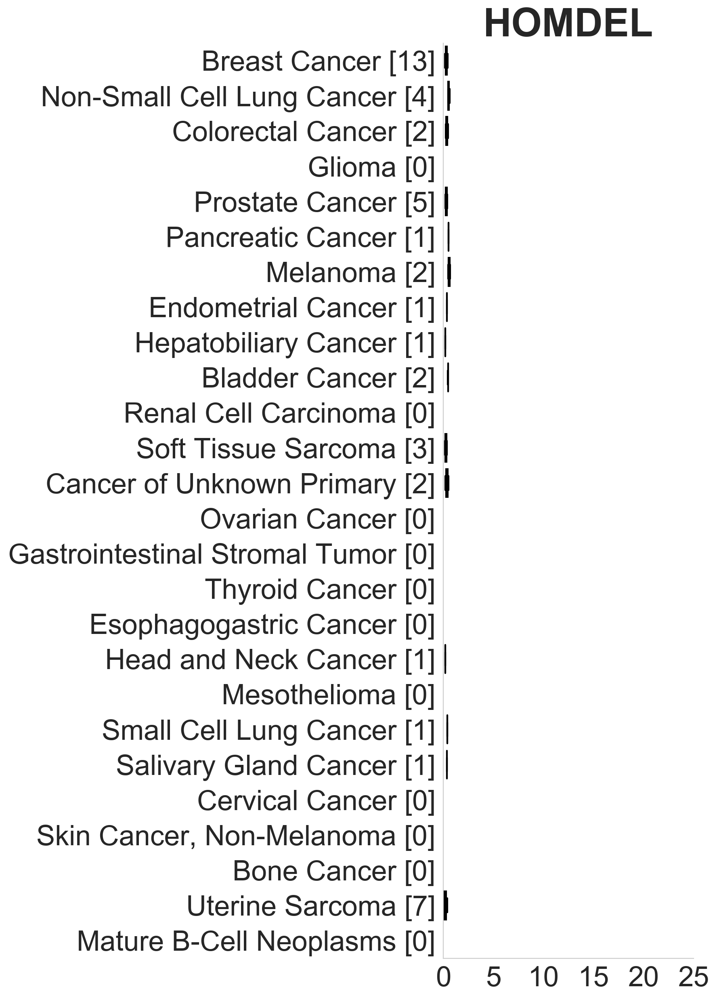

In [64]:
group_choice= 'tp53_group'
group = 'HOMDEL'
metrics = 'frac_genome_altered'
title = cancer_type
prim_met='Metastasis'
xlim=1
legend=False

fig, ax = plt.subplots(figsize=(4,15))

def boxplot_cancertype(master: pd.DataFrame, group_choice: str, group: str, ax, metrics: str, prim_met: str, xlim=25, legend=True, res_group = False):
    master_group = master[master[group_choice] == group][master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()][master['Sample_Type'] == prim_met][master['Cancer_Type'].isin(cancer_list)]
    palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
    group_list = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']
    
    if master_group.shape[0] == 0:
        for cancer in cancer_list:
            s1 = pd.Series([0]*master_group.shape[1], index=master_group.columns)
            master_group = master_group.append(s1, ignore_index=True)
        master_group['Cancer_Type'] = cancer_list
        
        if res_group:
            h=sns.boxplot(y='Cancer_Type',
                      x=metrics,
                      data=master_group,
                      ax=ax,
                      order=cancer_list,
                      color=res_palette_list[res_group_list.index(group)])


        else:
            h=sns.boxplot(y='Cancer_Type',
                          x=metrics,
                          data=master_group,
                          ax=ax,
                          order=cancer_list,
                          color=palette_list[group_list.index(group)])


        style(ax)
        ax.set_xlabel('')
        ax.set_title(group, fontsize=35, weight='bold')
        ax.set_ylabel('')
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

        if legend:
            ax.set_yticklabels([str(cancer) + ' [' + str(0) +  ']' for cancer in cancer_list])
        else : 
            ax.set_yticklabels(['[' + str(0) +  ']' for cancer in cancer_list])
        for tick in ax.yaxis.get_major_ticks():
            tick.label.set_fontsize(25) 
        for tick in ax.xaxis.get_major_ticks():
            tick.label.set_fontsize(25) 

        ax.set_xlim(0, xlim)
    
    else:
        if res_group:
            h=sns.boxplot(y='Cancer_Type',
                      x=metrics,
                      data=master_group,
                      ax=ax,
                      order=cancer_list,
                      color=res_palette_list[res_group_list.index(group)])


        else:
            h=sns.boxplot(y='Cancer_Type',
                          x=metrics,
                          data=master_group,
                          ax=ax,
                          order=cancer_list,
                          color=palette_list[group_list.index(group)])


        style(ax)
        ax.set_xlabel('')
        ax.set_title(group, fontsize=35, weight='bold')
        ax.set_ylabel('')
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

        if legend:
            ax.set_yticklabels([str(cancer) + ' [' + str(master_group[master_group['Cancer_Type'] == cancer].shape[0]) +  ']' for cancer in cancer_list])
        else : 
            ax.set_yticklabels(['[' + str(master_group[master_group['Cancer_Type'] == cancer].shape[0]) +  ']' for cancer in cancer_list])
        for tick in ax.yaxis.get_major_ticks():
            tick.label.set_fontsize(25) 
        for tick in ax.xaxis.get_major_ticks():
            tick.label.set_fontsize(25) 

        ax.set_xlim(0, xlim)
    

boxplot_cancertype(master,
                   group_choice=group_choice,
                   group=group,
                   ax=ax,
                   metrics=metrics,
                   prim_met=prim_met,
                   xlim=25,
                   legend=True,
                  res_group = False)


In [65]:
group_choice= 'tp53_group'
metrics = 'chr_affected'
title = cancer_type
prim_met='Metastasis'
xlim=25
title= 'Number of aberrant chromosomes - Metastatic Samples'

def panel_metrics(group_choice, metrics, title, prim_met, xlim):
    
    if group_choice == 'tp53_res_group': res='residual'
    else: res=''
    palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
    res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']

    group_list = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']
    res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
    fig = plt.figure(figsize=(50,30))
    if group_choice=='tp53_res_group':
        outer = gridspec.GridSpec(nrows=200, ncols=13)
        inner_1 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, :6],wspace=0.2, hspace=0)
        inner_2 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, 7:13],wspace=0.2, hspace=0)
        
        for i, group in enumerate(res_group_list):
            ax = plt.Subplot(fig, inner_1[i:i+1])
            if i == 0:
                boxplot_cancertype(master,
                           group_choice=group_choice,
                           group=group,
                           ax=ax,
                           metrics=metrics,
                           prim_met='Primary',
                           xlim=xlim,
                           legend=True,
                           res_group=True)
            else:
                boxplot_cancertype(master,
                                   group_choice=group_choice,
                                   group=group,
                                   ax=ax,
                                   metrics=metrics,
                                   prim_met='Primary',
                                   xlim=xlim,
                                   legend=False,
                                   res_group=True)
            fig.add_subplot(ax)
                
        for i, group in enumerate(res_group_list):
            ax = plt.Subplot(fig, inner_2[i:i+1])
            boxplot_cancertype(master,
                       group_choice=group_choice,
                       group=group,
                       ax=ax,
                       metrics=metrics,
                       prim_met='Metastasis',
                       xlim=xlim,
                       legend=False,
                       res_group=True)
            
            fig.add_subplot(ax)
              
    else: 
        outer = gridspec.GridSpec(nrows=1, ncols=6)
        inner = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=6, subplot_spec=outer[0:1, :6],wspace=0.2, hspace=0)
    
        for i, group in enumerate(group_list):
            ax = plt.Subplot(fig, inner[i])
            if i == 0:
                boxplot_cancertype(master,
                           group_choice=group_choice,
                           group=group,
                           ax=ax,
                           metrics=metrics,
                           prim_met=prim_met,
                           xlim=xlim,
                           legend=True)
            else:
                boxplot_cancertype(master,
                           group_choice=group_choice,
                           group=group,
                           ax=ax,
                           metrics=metrics,
                           prim_met=prim_met,
                           xlim=xlim,
                           legend=False)
            fig.add_subplot(ax)

    fig.subplots_adjust(left=0.15, bottom=0.10, right=0.92, top=0.88, wspace=1, hspace=2)
    fig.suptitle(title, fontsize=50,fontweight='bold')
    if group_choice == 'tp53_group':
        fig.savefig('./metrics_summaries_no_wgd/{}_{}.pdf'.format(metrics, prim_met), format='pdf')
    elif group_choice == 'tp53_res_group':
        fig.savefig('./metrics_summaries_no_wgd/{}_residual.pdf'.format(metrics), format='pdf')

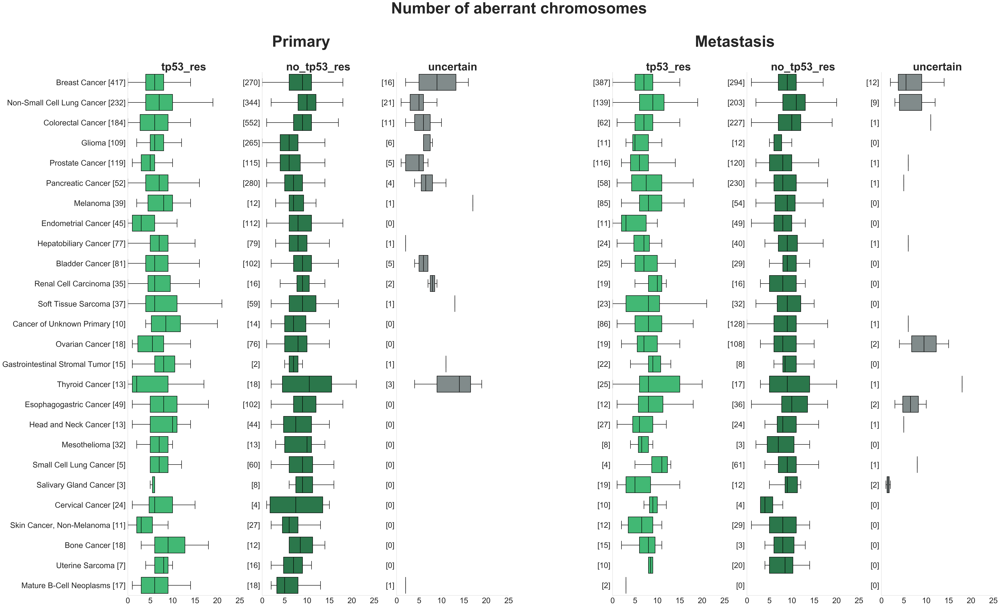

In [66]:
panel_metrics(group_choice='tp53_res_group', 
              metrics='chr_affected', 
              title='Number of aberrant chromosomes \n\n Primary                                                                                    Metastasis', 
              prim_met='Metastasis', 
              xlim=25)

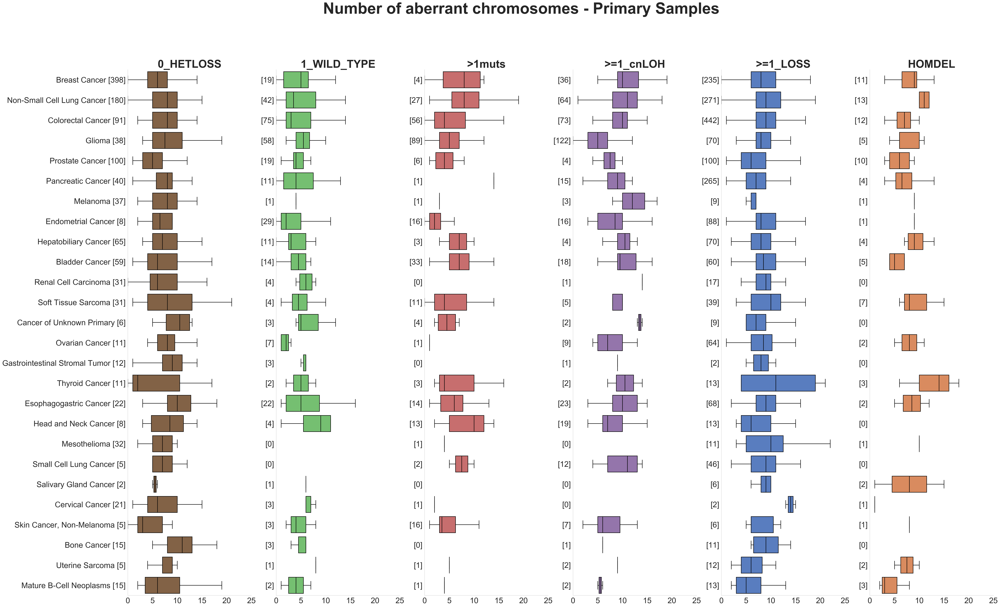

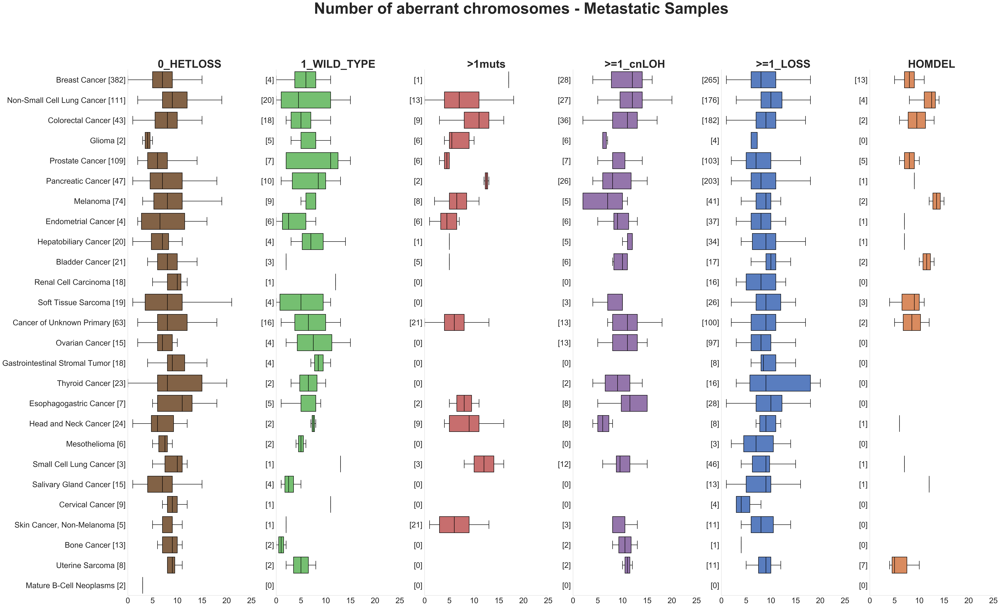

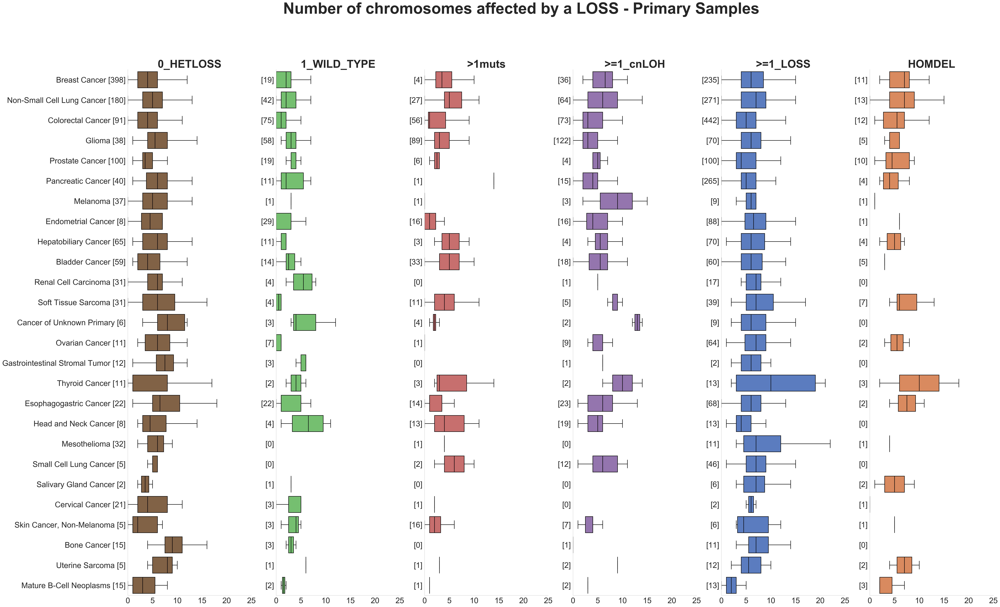

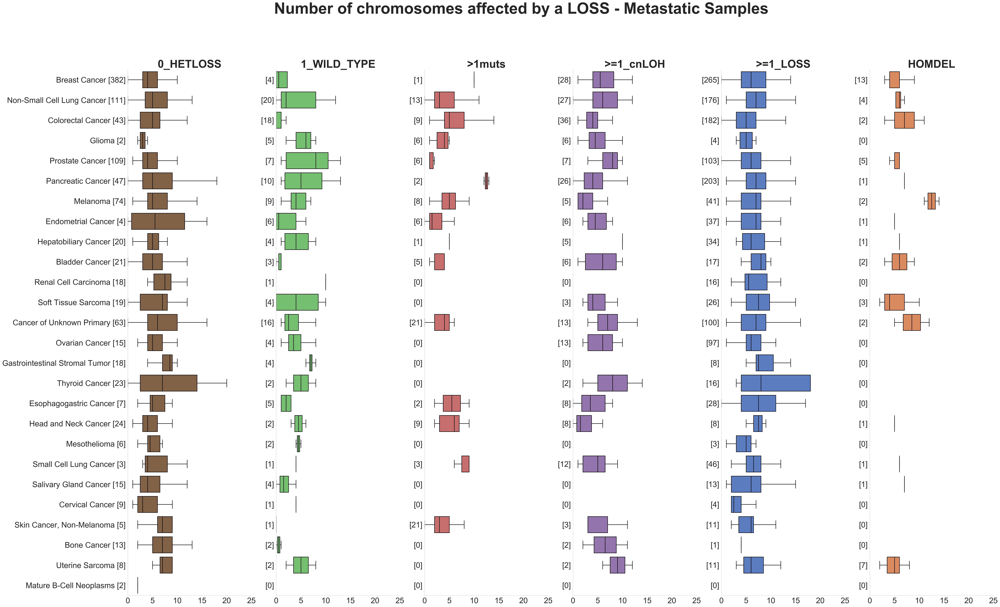

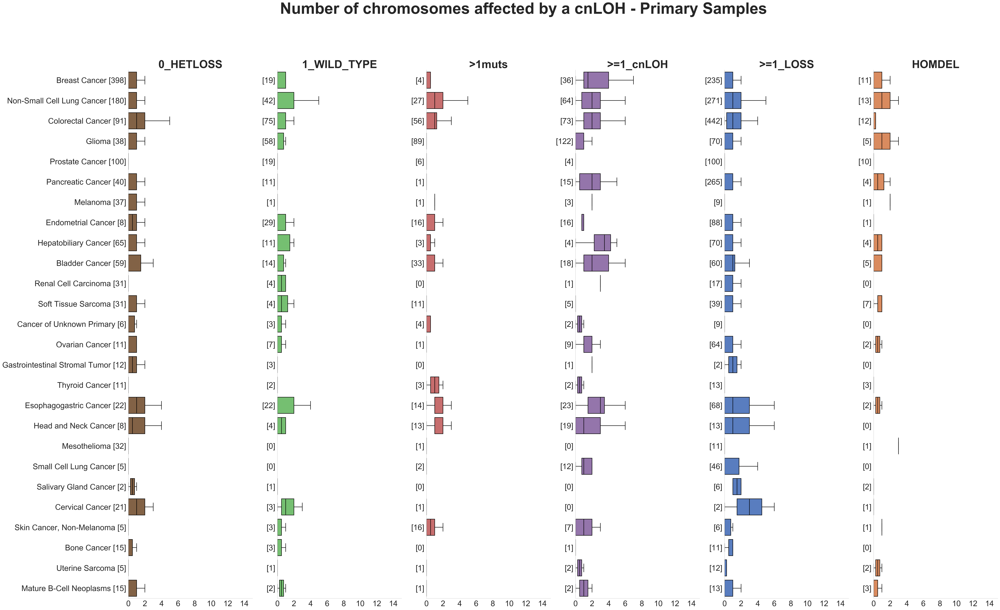

...

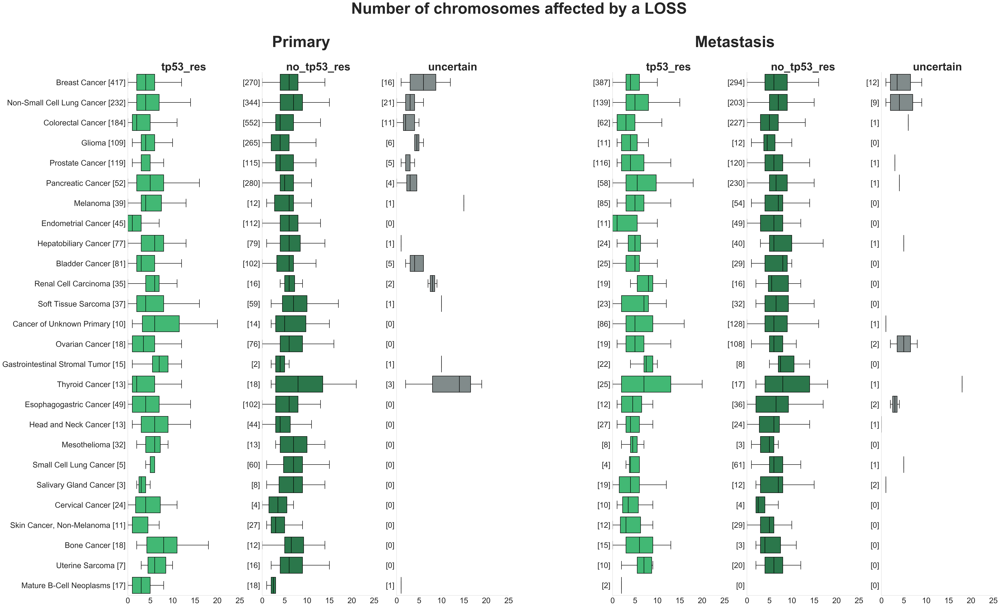

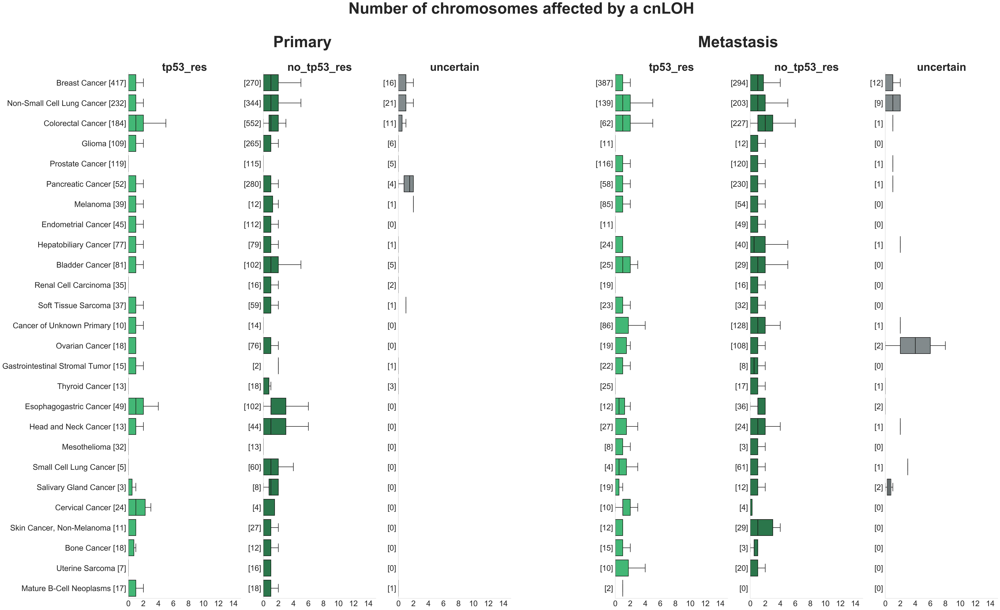

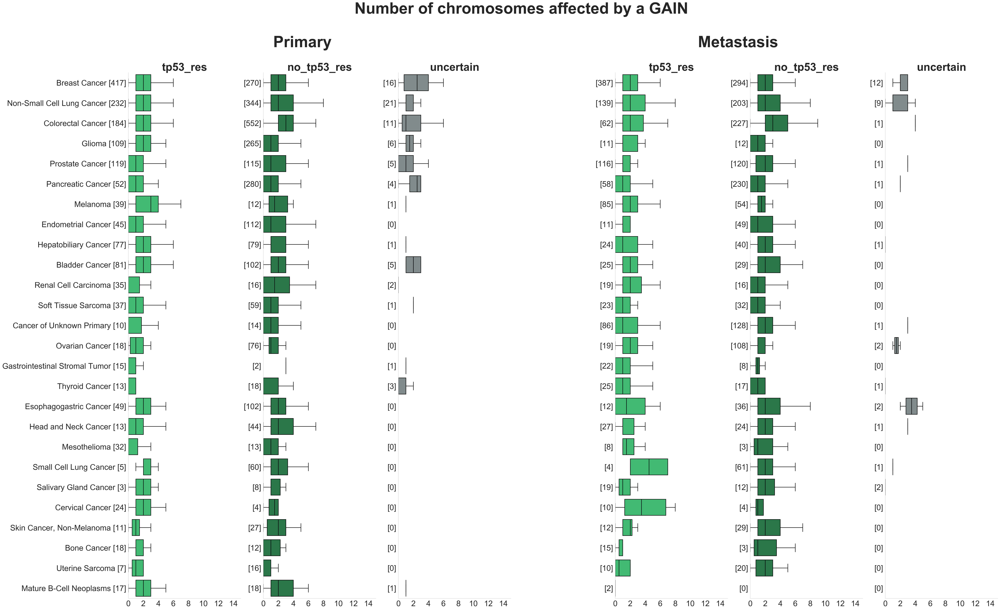

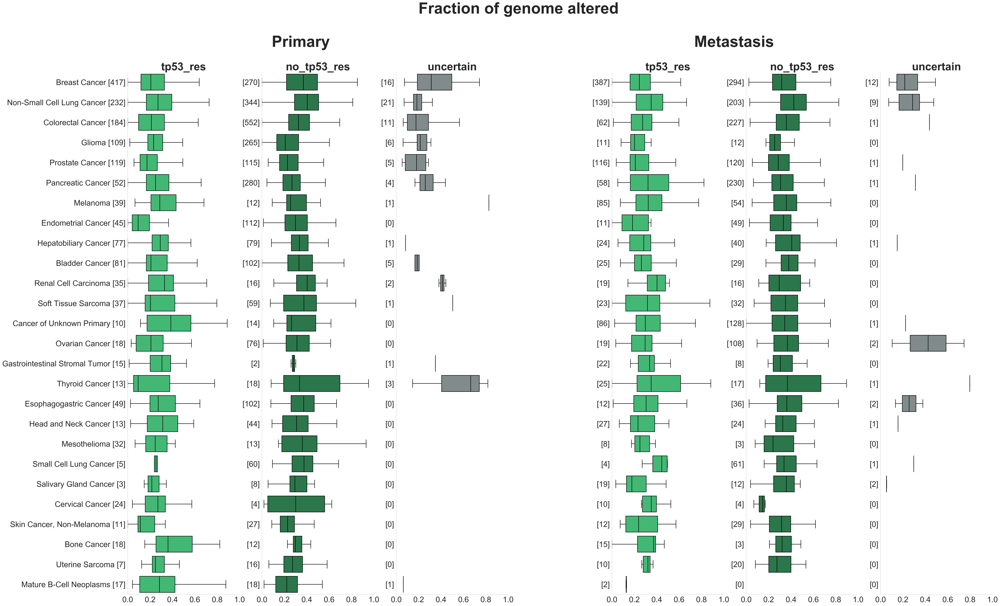

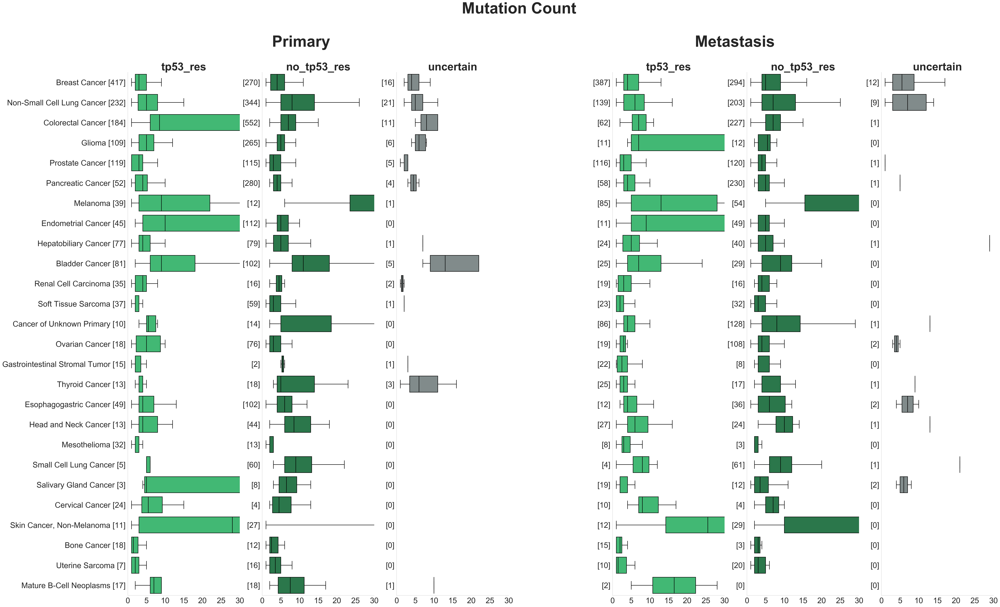

In [67]:
titles = ['Number of aberrant chromosomes - Primary Samples', 'Number of aberrant chromosomes - Metastatic Samples',
          'Number of chromosomes affected by a LOSS - Primary Samples', 'Number of chromosomes affected by a LOSS - Metastatic Samples',
          'Number of chromosomes affected by a cnLOH - Primary Samples','Number of chromosomes affected by a cnLOH - Metastatic Samples',
          'Number of chromosomes affected by a GAIN - Primary Samples','Number of chromosomes affected by a GAIN - Metastatic Samples',
          'Fraction of genome altered - Primary Samples','Fraction of genome altered - Metastatic Samples',
          'Mutation Count - Primary Samples','Mutation Count - Metastatic Samples']

titles_res = ['Number of aberrant chromosomes \n\n Primary                                                                                    Metastasis',
              'Number of chromosomes affected by a LOSS \n\n Primary                                                                                    Metastasis',
              'Number of chromosomes affected by a cnLOH \n\n Primary                                                                                    Metastasis',
              'Number of chromosomes affected by a GAIN \n\n Primary                                                                                    Metastasis',
              'Fraction of genome altered \n\n Primary                                                                                    Metastasis',
              'Mutation Count \n\n Primary                                                                                    Metastasis',
                ]


# First loop for tp53_group panels
i=0
group_choice='tp53_group'
for metrics in ['chr_affected', 'chr_loss', 'chr_cnloh', 'chr_gain', 'frac_genome_altered', 'mutation_count']:
    for prim_met in ['Primary', 'Metastasis']:
        if metrics in ['chr_loss', 'chr_cnloh', 'chr_gain']:
            if metrics == 'chr_loss':
                panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles[i], 
                          prim_met=prim_met, 
                          xlim=25)
            else: 
                panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles[i], 
                          prim_met=prim_met, 
                          xlim=15)
        elif metrics == 'frac_genome_altered':
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles[i], 
                          prim_met=prim_met, 
                          xlim=1)
        elif metrics=='mutation_count':
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles[i], 
                          prim_met=prim_met, 
                          xlim=30)
        else :
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles[i], 
                          prim_met=prim_met, 
                          xlim=25)
        i+=1
   

# Second loop for tp53_res_group panels
group_choice='tp53_res_group'
i_res = 0
for metrics in ['chr_affected', 'chr_loss', 'chr_cnloh', 'chr_gain', 'frac_genome_altered', 'mutation_count']:
        if metrics in ['chr_loss', 'chr_cnloh', 'chr_gain']:
            if metrics == 'chr_loss':
                panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles_res[i_res], 
                          prim_met='Metastasis', 
                          xlim=25)
            else: 
                panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles_res[i_res], 
                          prim_met='Metastasis', 
                          xlim=15)
        elif metrics == 'frac_genome_altered':
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles_res[i_res], 
                          prim_met='Metastasis', 
                          xlim=1)
        elif metrics=='mutation_count':
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles_res[i_res], 
                          prim_met='Metastasis', 
                          xlim=30)
        else :
            panel_metrics(group_choice=group_choice, 
                          metrics=metrics, 
                          title=titles_res[i_res], 
                          prim_met='Metastasis', 
                          xlim=25)
        i_res+=1

## Legend Plot

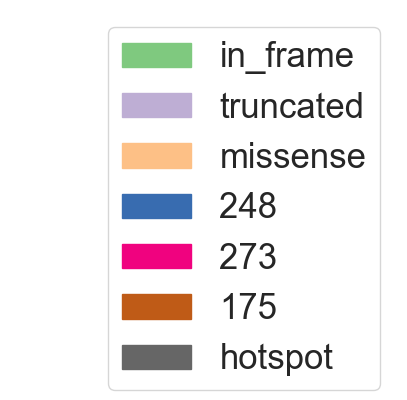

In [29]:
fig, ax = plt.subplots(figsize=(5,1))
# Create a color palette
acc = list(sns.color_palette("Accent"))

mutation_list = ['in_frame','truncated', 'missense', '248', '273', '175', 'hotspot']
res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
mutation_palette_lits = acc[:3] + acc[4:8]

palette = dict(zip(mutation_list, mutation_palette_lits))
# Create legend handles manually
handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
# Create legend
ax.legend(handles=handles, fontsize=25, loc='centered')
# Get current axes object and turn off axis
ax.set_axis_off()
plt.show()

# Hotspot Distribution

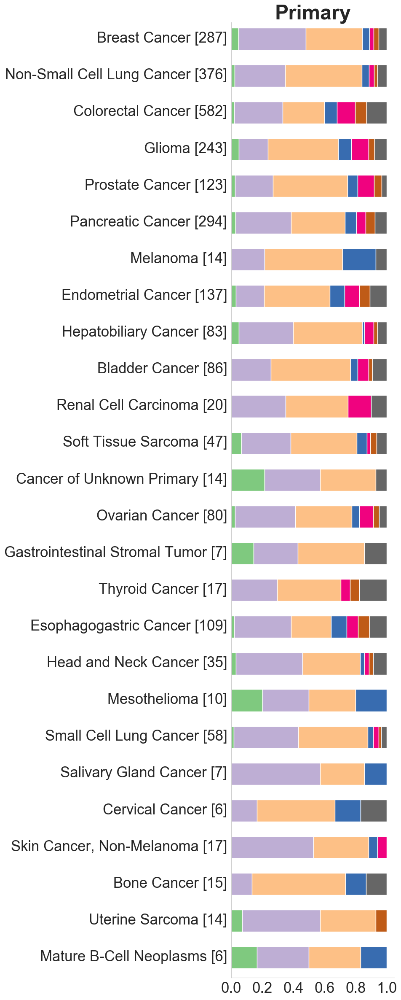

In [30]:
sns.set_style("whitegrid", {'grid.color': '1.'})
prim_met = 'Metastasis'
metrics='tp53_group'
fig, ax = plt.subplots(figsize=(5,30))

def plot_metrics_cancerlist(master: pd.DataFrame, metrics: str, prim_met: str, ax,  legend=True):
    for i, cancer_type in enumerate(cancer_list):
        master_cancer = master[master['Cancer_Type'] == cancer_type][master['tp53_cn_state'] != 'INDETERMINATE'][master['tp53_count'] == 1][~master['tp53_cn_state'].isna()]
        count_prim_met = get_groupby(master_cancer[master_cancer['Sample_Type'] == prim_met], metrics, 'count_prim_met' + metrics)
        freq_prim_met = pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sort_values(by=['count_prim_met' + metrics], ascending=False)/ pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum()
        
        
        if legend:
            freq_prim_met.columns=[cancer_type + ' ' + str(pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum().values)]
        else:
            freq_prim_met.columns=[str(pd.DataFrame(count_prim_met['count_prim_met' + metrics]).sum().values)]
        if metrics == 'tp53_res_group':
            freq_prim_met = freq_prim_met.reindex(res_group_list)
        if metrics == 'tp53_res_group':
            freq_prim_met = freq_prim_met.reindex(res_group_list)
        elif metrics == 'tp53_vc_group_1':
            freq_prim_met = freq_prim_met.reindex(mutation_list)
        if i==0:
            freq_prim_met_final = freq_prim_met.T
        else : freq_prim_met_final = pd.concat([freq_prim_met_final, freq_prim_met.T], axis=0)

    freq_prim_met_final = freq_prim_met_final.fillna(0)

    if metrics == 'tp53_res_group':
        h = freq_prim_met_final[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], color=res_palette_list)
    elif metrics == 'tp53_group':
        h = freq_prim_met_final[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], color=palette_list)
    elif metrics == 'tp53_vc_group_1':
        h = freq_prim_met_final[::-1].plot(kind = 'barh', stacked=True, ax=ax, yticks=[0,0.25,0.5,0.75,1], colormap="Accent")
        

    ax.set_title(prim_met, weight = 'bold', fontsize=35)
    ax.legend_.remove()

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    

    for container in ax.containers:
        for i, child in enumerate(container.get_children()):
            child.set_height(0.6)

    ax.set_yticks([k + 0.1 for k in list(range(len(cancer_list)))])
    
    #if legend == False:
    #h.axes.get_yaxis().set_ticks([])
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    
plot_metrics_cancerlist(master=master,
                        metrics='tp53_vc_group_1', 
                        prim_met='Primary', 
                        ax=ax,  
                        legend=True)

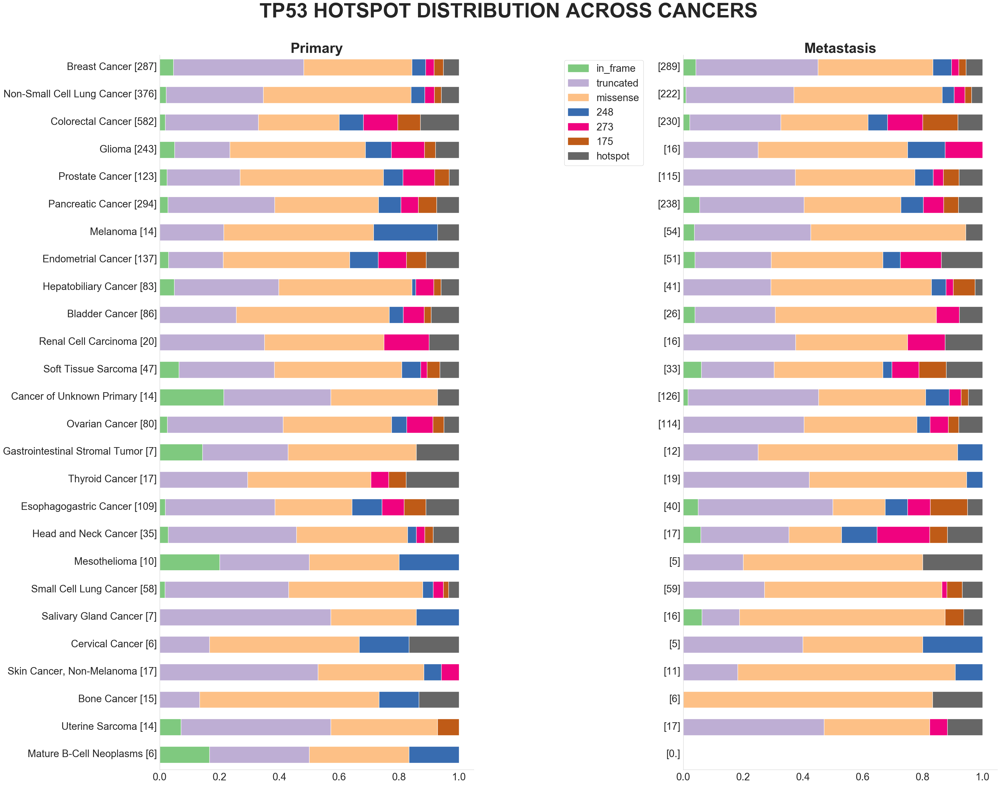

In [32]:
fig = plt.figure(figsize=(40,30))
outer = gridspec.GridSpec(nrows=1, ncols=5)
inner = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=5, subplot_spec=outer[:1, :5],wspace=0.25, hspace=0)

ax_prim = plt.Subplot(fig, inner[0:2])
ax_legend = plt.Subplot(fig, inner[2])
ax_met = plt.Subplot(fig, inner[3:5])

plot_metrics_cancerlist(master=master,
                        metrics='tp53_vc_group_1', 
                        prim_met='Primary', 
                        ax=ax_prim,  
                        legend=True)

# Create a color palette
acc = list(sns.color_palette("Accent"))

mutation_list = ['in_frame','truncated', 'missense', '248', '273', '175', 'hotspot']
res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
mutation_palette_lits = acc[:3] + acc[4:8]

palette = dict(zip(mutation_list, mutation_palette_lits))
# Create legend handles manually
handles = [matplotlib.patches.Patch(color=palette[x], label=x) for x in palette.keys()]
# Create legend
ax_legend.legend(handles=handles, fontsize=25, loc='left')
# Get current axes object and turn off axis
ax_legend.set_axis_off()

plot_metrics_cancerlist(master=master,
                        metrics='tp53_vc_group_1', 
                        prim_met='Metastasis', 
                        ax=ax_met,  
                        legend=False)

fig.add_subplot(ax_prim)
fig.add_subplot(ax_met)
fig.add_subplot(ax_legend)

fig.subplots_adjust(left=0.2, bottom=0.10, right=0.92, top=0.92, wspace=1, hspace=1)
fig.suptitle('TP53 HOTSPOT DISTRIBUTION ACROSS CANCERS', fontsize=50,fontweight='bold')
fig.savefig('./metrics_summaries_no_wgd/hotspot_proportions.pdf', format='pdf')

# Merging all metrics panels in 1 PDF

In [33]:
import os
from PyPDF2 import PdfFileMerger

pdfs = os.listdir("./metrics_summaries_no_wgd/")
merger = PdfFileMerger()

new_pdfs = ['res_group_proportions.pdf',
         'subgroup_proportions.pdf',
            'hotspot_proportions.pdf',

         'frac_genome_altered_residual.pdf',
         'frac_genome_altered_Primary.pdf',
         'frac_genome_altered_Metastasis.pdf',

         'chr_affected_residual.pdf',
         'chr_affected_Primary.pdf',
         'chr_affected_Metastasis.pdf',

         'chr_loss_residual.pdf',
         'chr_loss_Primary.pdf',
         'chr_loss_Metastasis.pdf',

         'chr_cnloh_residual.pdf',
         'chr_cnloh_Primary.pdf',
         'chr_cnloh_Metastasis.pdf',

         'chr_gain_residual.pdf',
         'chr_gain_Primary.pdf',
         'chr_gain_Metastasis.pdf',


         'wgd_residual.pdf',
         'wgd_Primary.pdf',
         'wgd_Metastasis.pdf',

         'mutation_count_residual.pdf',
         'mutation_count_Primary.pdf',
         'mutation_count_Metastasis.pdf'
         ]

for pdf in new_pdfs:
    if("pdf" in pdf):
          merger.append("./metrics_summaries_no_wgd/"+pdf)

merger.write("./ALL_METRICS_PANEL_NO_WGD.pdf")
merger.close()

# WGD Normalisation

In [22]:
def f(x):
    if x.wgd == 1 : 
        if x.tp53_res_group == 'tp53_res':
            return 'tp53_res_wgd'
        if x.tp53_res_group == 'no_tp53_res':
            return 'no_tp53_res_wgd'
        if x.tp53_res_group == 'uncertain':
            return 'uncertain_wgd'

    if x.wgd == -1 : 
        if x.tp53_res_group == 'tp53_res':
            return 'tp53_res_no_wgd'
        if x.tp53_res_group == 'no_tp53_res':
            return 'no_tp53_res_no_wgd'
        if x.tp53_res_group == 'uncertain':
            return 'uncertain_no_wgd'
        
        
palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']

group_list = ['0_HETLOSS', '1_WILD_TYPE', '>1muts', '>=1_cnLOH', '>=1_LOSS','HOMDEL']
res_group_list = ['tp53_res', 'no_tp53_res', 'uncertain']
master = load_clean_up_master(data_path + 'merged_data/master_file.pkl')
master['tp53_res_wgd_group'] = master.apply(f, axis=1)
# We remove INDETERMINATE and NaN tp53_cn_state samples
master_cancer = master[master['Cancer_Type'] == cancer_type][master['tp53_cn_state'] != 'INDETERMINATE'][~master['tp53_cn_state'].isna()]

In [23]:
master_cancer

,Sample_Id,Tumor_Id,Patient_Id,Cancer_Type,Cancer_Type_Detailed,Sample_Type,purity,ploidy,samples_per_patient,Overall Survival Status,Overall Survival (Months),MSI Score,TMB_Score,Patient_Current_Age,Sex,Ethnicity_Category,Race_Category,mutationStatus,Somatic_Status,tp53_key_1,tp53_vc_1,tp53_ccf_1,tp53_vaf_1,tp53_HGVSp_1,tp53_spot_1,tp53_key_2,tp53_vc_2,tp53_ccf_2,tp53_vaf_2,tp53_HGVSp_2,tp53_spot_2,tp53_key_3,tp53_vc_3,tp53_ccf_3,tp53_vaf_3,tp53_HGVSp_3,tp53_spot_3,tp53_key_4,tp53_vc_4,tp53_ccf_4,tp53_vaf_4,tp53_HGVSp_4,tp53_spot_4,tp53_key_5,tp53_vc_5,tp53_ccf_5,tp53_vaf_5,tp53_HGVSp_5,tp53_spot_5,tp53_count,tp53_tcn,tp53_mcn,tp53_lcn,tp53_seg_length,tp53_cn_state,tp53_cf,wgd,mutation_count,gene_count,driver_count,max_vaf,tp53_exp_nb_1,tp53_exp_nb_2,tp53_exp_nb_3,tp53_exp_nb_4,tp53_exp_nb_5,tp53_residual_1,tp53_residual_2,tp53_residual_3,tp53_residual_4,tp53_residual_5,tp53_first_group,tp53_group,tp53_res_group,chr_affected,chr_loss,chr_gain,chr_cnloh,frac_genome_altered,tp53_vc_group_1,tp53_vc_group_2,tp53_vc_group_3,tp53_vc_group_4,tp53_vc_group_5,tp53_res_wgd_group
3,P-0027408-T01-IM6_P-0027408-N01-IM6,P-0027408-T01-IM6,P-0027408,Non-Small Cell Lung Cancer,Non-Small Cell Lung Cancer,Metastasis,0.308886,1.811066,1.0,LIVING,22.586,0.27,17.6,67.0,Female,Non-Spanish; Non-Hispanic,WHITE,SOMATIC,Matched,P-0027408-T01-IM617_7578409_CT_TC,Missense_Mutation,0.925,0.168901,p.Arg174Glu,174,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1.0,1.0,0.0,26256025.0,HETLOSS,0.275073,-1.0,20,18.0,0,0.192475,0.924711,NaN,NaN,NaN,NaN,0.075289,NaN,NaN,NaN,NaN,LOSS,>=1_LOSS,no_tp53_res,12,11,3,0,0.444,missense,None,None,None,None,no_tp53_res_no_wgd
6,P-0036909-T01-IM6_P-0036909-N01-IM6,P-0036909-T01-IM6,P-0036909,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,Metastasis,0.384643,2.871793,4.0,LIVING,14.137,0.37,3.5,47.0,Female,Non-Spanish; Non-Hispanic,WHITE,SOMATIC,Matched,P-0036909-T01-IM617_7577121_G_A,Missense_Mutation,0.812,0.312169,p.Arg273Cys,273,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,2.0,2.0,0.0,18101929.0,LOSS BEFORE,0.306121,1.0,4,3.0,0,0.312169,1.623166,NaN,NaN,NaN,NaN,0.376834,NaN,NaN,NaN,NaN,cnLOH,>=1_cnLOH,no_tp53_res,19,19,1,2,0.839,273,None,None,None,None,no_tp53_res_wgd
13,P-0036570-T02-IM6_P-0036570-N01-IM6,P-0036570-T02-IM6,P-0036570,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,Primary,0.244677,1.714611,2.0,LIVING,13.611,0.00,3.5,71.0,Female,Non-Spanish; Non-Hispanic,WHITE,SOMATIC,Matched,P-0036570-T02-IM617_7577529_A_T,Missense_Mutation,1.000,0.156652,p.Ile251Asn,251,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1.0,1.0,0.0,14319106.0,HETLOSS,0.250258,-1.0,4,4.0,0,0.161290,1.123828,NaN,NaN,NaN,NaN,-0.123828,NaN,NaN,NaN,NaN,LOSS,>=1_LOSS,no_tp53_res,14,8,6,1,0.62,missense,None,None,None,None,no_tp53_res_no_wgd
32,P-0010030-T01-IM5_P-0010030-N01-IM5,P-0010030-T01-IM5,P-0010030,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,Metastasis,0.716531,3.089369,1.0,DECEASED,16.405,1.98,10.8,72.0,Female,Non-Spanish; Non-Hispanic,WHITE,SOMATIC,Matched,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,0,2.0,2.0,0.0,29368249.0,LOSS BEFORE,0.631585,1.0,11,11.0,0,0.739000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,cnLOH,None,None,20,17,3,7,0.893,None,None,None,None,None,None
54,P-0004517-T01-IM5_P-0004517-N01-IM5,P-0004517-T01-IM5,P-0004517,Non-Small Cell Lung Cancer,Lung Squamous Cell Carcinoma,Metastasis,0.767015,1.881846,1.0,DECEASED,20.975,2.39,13.8,69.0,Male,Non-Spanish; Non-Hispanic,BLACK OR AFRICAN AMERICAN,SOMATIC,Matched,P-0004517-T01-IM517_7578469_C_A,Missense_Mutation,1.000,0.684783,p.Gly154Val,154,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,None,None,NaN,NaN,None,None,1,1.0,1.0,0.0,24518704.0,HETLOSS

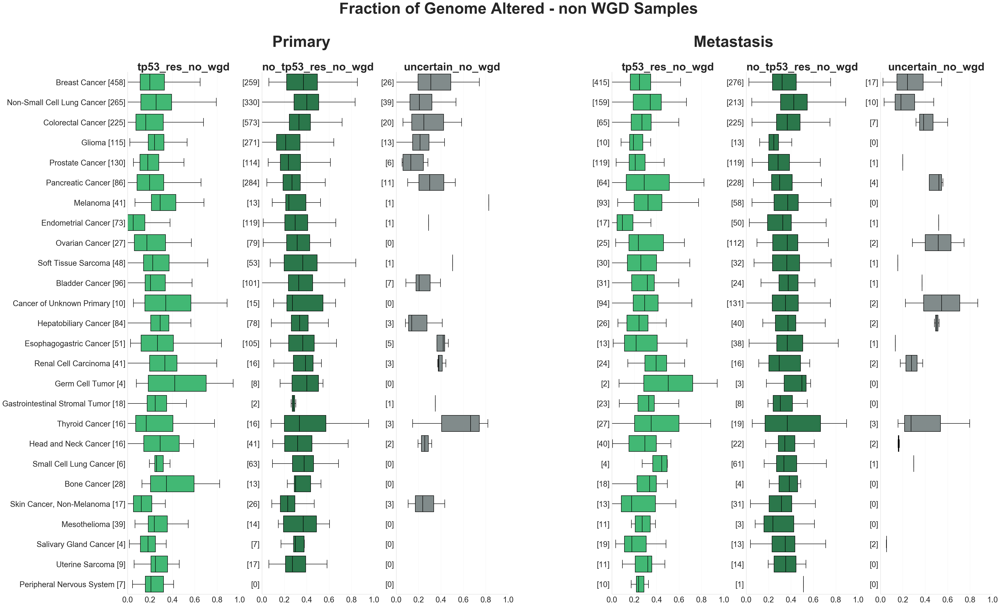

In [33]:
group_choice = 'tp53_res_wgd_group'
res='residual'
metrics= 'frac_genome_altered'
xlim=1

palette_list = [mc[5],mc[2],mc[3],mc[4],mc[0],mc[1]]
res_palette_list = ['#2ECC71','#1E8449','#7F8C8D']

res_group_list = ['tp53_res_no_wgd', 'no_tp53_res_no_wgd', 'uncertain_no_wgd']
fig = plt.figure(figsize=(50,30))

if group_choice=='tp53_res_wgd_group':
    outer = gridspec.GridSpec(nrows=200, ncols=13)
    inner_1 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, :6],wspace=0.2, hspace=0)
    inner_2 = gridspec.GridSpecFromSubplotSpec(nrows=1, ncols=3, subplot_spec=outer[1:200, 7:13],wspace=0.2, hspace=0)

    for i, group in enumerate(res_group_list):
        ax = plt.Subplot(fig, inner_1[i:i+1])
        if i == 0:
            boxplot_cancertype(master,
                       group_choice=group_choice,
                       group=group,
                       ax=ax,
                       metrics=metrics,
                       prim_met='Primary',
                       xlim=xlim,
                       legend=True,
                       res_group=True)
        else:
            boxplot_cancertype(master,
                               group_choice=group_choice,
                               group=group,
                               ax=ax,
                               metrics=metrics,
                               prim_met='Primary',
                               xlim=xlim,
                               legend=False,
                               res_group=True)
        fig.add_subplot(ax)

    for i, group in enumerate(res_group_list):
        ax = plt.Subplot(fig, inner_2[i:i+1])
        boxplot_cancertype(master,
                   group_choice=group_choice,
                   group=group,
                   ax=ax,
                   metrics=metrics,
                   prim_met='Metastasis',
                   xlim=xlim,
                   legend=False,
                   res_group=True)

        fig.add_subplot(ax)


fig.subplots_adjust(left=0.15, bottom=0.10, right=0.92, top=0.88, wspace=1, hspace=2)
title='Fraction of Genome Altered - non WGD Samples \n\n Primary                                                                                    Metastasis'
fig.suptitle(title, fontsize=50,fontweight='bold')
fig.savefig('./metrics_summaries/{}_residual_no_wgd.pdf'.format(metrics), format='pdf')